<a href="https://colab.research.google.com/github/aravind598/Data_Science_Proj/blob/master/Data%20Science%20Project/Variable_Relationship.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Import Libraries


In [0]:
#Run This

In [0]:
  import numpy as np
  import pandas as pd
  import seaborn as sb
  import matplotlib.pyplot as plt # we only need pyplot
  sb.set() # set the default Seaborn style for graphics
  import statsmodels.api as sm
  %matplotlib inline
  from sklearn.model_selection import train_test_split
  from sklearn.linear_model import LinearRegression
  from sklearn.feature_selection import RFE
  from sklearn.linear_model import RidgeCV, LassoCV, Ridge, Lasso
  from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier, GradientBoostingClassifier, ExtraTreesClassifier
  from sklearn.tree import DecisionTreeClassifier
  from sklearn import metrics
  from sklearn.metrics import classification_report
  from sklearn.metrics import accuracy_score
  from sklearn.metrics import confusion_matrix
  from sklearn.tree import export_graphviz
  from sklearn.model_selection import GridSearchCV
  import graphviz
  import plotly.offline as py
  import plotly.figure_factory as ff
  import plotly.graph_objs as go
  from plotly.subplots import make_subplots
  from plotly import tools
  import cufflinks as cf

# Data Section

In [0]:
#Run This Very Important

In [0]:
url = 'https://raw.githubusercontent.com/aravind598/Github/aravind598/train_labels.csv?token=ANW7SFFLH4MDRNIQ6CZDX4K6Q34HM'
urll = 'https://raw.githubusercontent.com/aravind598/Github/aravind598/train_values.csv?token=ANW7SFAFKK4PCQRTQ4VAZOC6Q34HS'
url2 = 'https://raw.githubusercontent.com/aravind598/Github/aravind598/test_values.csv?token=ANW7SFDQHUPFIZR3Q5NVDWS6Q5PNG'

In [0]:
#Run This Very important

In [0]:
df1 = pd.read_csv(url)
df2 = pd.read_csv(urll)
df3 = pd.merge(df2,df1)
test_data = pd.read_csv(url2)


In [0]:
numericdata = pd.DataFrame(df3[['geo_level_1_id',	'geo_level_2_id',	'geo_level_3_id',	'count_floors_pre_eq',	'age',	'area_percentage',	'height_percentage',
                            'has_superstructure_adobe_mud',	'has_superstructure_mud_mortar_stone',	
                            'has_superstructure_stone_flag',	'has_superstructure_cement_mortar_stone',	'has_superstructure_mud_mortar_brick',	
                            'has_superstructure_cement_mortar_brick',	'has_superstructure_timber',	'has_superstructure_bamboo',	'has_superstructure_rc_non_engineered',
                            'has_superstructure_rc_engineered',	'has_superstructure_other',	'count_families',	'has_secondary_use',	
                            'has_secondary_use_agriculture',	'has_secondary_use_hotel',	'has_secondary_use_rental',	'has_secondary_use_institution',	
                            'has_secondary_use_school',	'has_secondary_use_industry',	'has_secondary_use_health_post',	'has_secondary_use_gov_office',	
                            'has_secondary_use_use_police',	'has_secondary_use_other', 'damage_grade']])

catData = pd.DataFrame(df3[['land_surface_condition','foundation_type','roof_type','ground_floor_type','other_floor_type','position','plan_configuration','legal_ownership_status']])

numeric_testdata = pd.DataFrame(test_data[['geo_level_1_id',	'geo_level_2_id',	'geo_level_3_id',	'count_floors_pre_eq',	'age',	'area_percentage',	'height_percentage',
                            'has_superstructure_adobe_mud',	'has_superstructure_mud_mortar_stone',	
                            'has_superstructure_stone_flag',	'has_superstructure_cement_mortar_stone',	'has_superstructure_mud_mortar_brick',	
                            'has_superstructure_cement_mortar_brick',	'has_superstructure_timber',	'has_superstructure_bamboo',	'has_superstructure_rc_non_engineered',
                            'has_superstructure_rc_engineered',	'has_superstructure_other',	'count_families',	'has_secondary_use',	
                            'has_secondary_use_agriculture',	'has_secondary_use_hotel',	'has_secondary_use_rental',	'has_secondary_use_institution',	
                            'has_secondary_use_school',	'has_secondary_use_industry',	'has_secondary_use_health_post',	'has_secondary_use_gov_office',	
                            'has_secondary_use_use_police',	'has_secondary_use_other']])

numtrain = pd.DataFrame(df3[['geo_level_1_id',	'geo_level_2_id',	'geo_level_3_id',	'count_floors_pre_eq',	'age',	'area_percentage',	'height_percentage',
                            'has_superstructure_adobe_mud',	'has_superstructure_mud_mortar_stone',	
                            'has_superstructure_stone_flag',	'has_superstructure_cement_mortar_stone',	'has_superstructure_mud_mortar_brick',	
                            'has_superstructure_cement_mortar_brick',	'has_superstructure_timber',	'has_superstructure_bamboo',	'has_superstructure_rc_non_engineered',
                            'has_superstructure_rc_engineered',	'has_superstructure_other',	'count_families',	'has_secondary_use',
                            'has_secondary_use_agriculture',	'has_secondary_use_hotel',	'has_secondary_use_rental',	'has_secondary_use_institution',	
                            'has_secondary_use_school',	'has_secondary_use_industry',	'has_secondary_use_health_post',	'has_secondary_use_gov_office',	
                            'has_secondary_use_use_police',	'has_secondary_use_other']])
alldata = pd.DataFrame(df3[['geo_level_1_id',	'geo_level_2_id',	'geo_level_3_id'	,'count_floors_pre_eq',	'age'	,'area_percentage',	'height_percentage'	,'land_surface_condition'	,
                            'foundation_type',	'roof_type',	'ground_floor_type'	,'other_floor_type'	,'position'	,'plan_configuration',	'has_superstructure_adobe_mud',	
                            'has_superstructure_mud_mortar_stone'	,'has_superstructure_stone_flag',	'has_superstructure_cement_mortar_stone',	'has_superstructure_mud_mortar_brick'	,
                            'has_superstructure_cement_mortar_brick',	'has_superstructure_timber',	'has_superstructure_bamboo',	'has_superstructure_rc_non_engineered',	
                            'has_superstructure_rc_engineered'	, 'has_superstructure_other',	'legal_ownership_status',	'count_families',	'has_secondary_use',	
                            'has_secondary_use_agriculture',	'has_secondary_use_hotel'	,'has_secondary_use_rental'	,'has_secondary_use_institution',	'has_secondary_use_school',
                            'has_secondary_use_industry','has_secondary_use_health_post',	'has_secondary_use_gov_office',	'has_secondary_use_use_police',	'has_secondary_use_other']])
#With Categorical Values as Dummmies
xingdata = pd.DataFrame(pd.get_dummies(catData, columns=catData.columns, drop_first=True))
lastData = numtrain.join(xingdata)


numtest = pd.DataFrame(test_data)
num = round(0.8*len(numtrain.index))
no = len(numtrain.index) - num
dog = num + no



In [0]:
print(len(df3))
df3.head()

260601


,building_id,geo_level_1_id,geo_level_2_id,geo_level_3_id,count_floors_pre_eq,age,area_percentage,height_percentage,land_surface_condition,foundation_type,roof_type,ground_floor_type,other_floor_type,position,plan_configuration,has_superstructure_adobe_mud,has_superstructure_mud_mortar_stone,has_superstructure_stone_flag,has_superstructure_cement_mortar_stone,has_superstructure_mud_mortar_brick,has_superstructure_cement_mortar_brick,has_superstructure_timber,has_superstructure_bamboo,has_superstructure_rc_non_engineered,has_superstructure_rc_engineered,has_superstructure_other,legal_ownership_status,count_families,has_secondary_use,has_secondary_use_agriculture,has_secondary_use_hotel,has_secondary_use_rental,has_secondary_use_institution,has_secondary_use_school,has_secondary_use_industry,has_secondary_use_health_post,has_secondary_use_gov_office,has_secondary_use_use_police,has_secondary_use_other,damage_grade
0,802906,6,487,12198,2,30,6,5,t,r,n,f,q,t,d,1,1,0,0,0,0,0,0,0,0,0,v,1,0,0,0,0,0,0,0,0,0,0,0,3
1,28830,8,900,2812,2,10,8,7,o,r,n,x,q,s,d,0,1,0,0,0,0,0,0,0,0,0,v,1,0,0,0,0,0,0,0,0,0,0,0,2
2,94947,21,363,8973,2,10,5,5,t,r,n,f,x,t,d,0,1,0,0,0,0,0,0,0,0,0,v,1,0,0,0,0,0,0,0,0,0,0,0,3
3,590882,22,418,10694,2,10,6,5,t,r,n,f,x,s,d,0,1,0,0,0,0,1,1,0,0,0,v,1,0,0,0,0,0,0,0,0,0,0,0,2
4,201944,11,131,1488,3,30,8,9,t,r,n,f,x,s,d,1,0,0,0,0,0,0,0,0,0,0,v,1,0,0,0,0,0,0,0,0,0,0,0,3


In [0]:
df3.describe()

,building_id,geo_level_1_id,geo_level_2_id,geo_level_3_id,count_floors_pre_eq,age,area_percentage,height_percentage,has_superstructure_adobe_mud,has_superstructure_mud_mortar_stone,has_superstructure_stone_flag,has_superstructure_cement_mortar_stone,has_superstructure_mud_mortar_brick,has_superstructure_cement_mortar_brick,has_superstructure_timber,has_superstructure_bamboo,has_superstructure_rc_non_engineered,has_superstructure_rc_engineered,has_superstructure_other,count_families,has_secondary_use,has_secondary_use_agriculture,has_secondary_use_hotel,has_secondary_use_rental,has_secondary_use_institution,has_secondary_use_school,has_secondary_use_industry,has_secondary_use_health_post,has_secondary_use_gov_office,has_secondary_use_use_police,has_secondary_use_other,damage_grade
count,2.606010e+05,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000,260601.000000
mean,5.256755e+05,13.900353,701.074685,6257.876148,2.129723,26.535029,8.018051,5.434365,0.088645,0.761935,0.034332,0.018235,0.068154,0.075268,0.254988,0.085011,0.042590,0.015859,0.014985,0.983949,0.111880,0.064378,0.033626,0.008101,0.000940,0.000361,0.001071,0.000188,0.000146,0.000088,0.005119,2.238272
std,3.045450e+05,8.033617,412.710734,3646.369645,0.727665,73.565937,4.392231,1.918418,0.284231,0.425900,0.182081,0.133800,0.252010,0.263824,0.435855,0.278899,0.201931,0.124932,0.121491,0.418389,0.315219,0.245426,0.180265,0.089638,0.030647,0.018989,0.032703,0.013711,0.012075,0.009394,0.071364,0.611814
min,4.000000e+00,0.000000,0.000000,0.000000,1.000000,0.000000,1.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
25%,2.611900e+05,7.000000,350.000000,3073.000000,2.000000,10.000000,5.000000,4.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000
50%,5.257570e+05,12.000000,702.000000,6270.000000,2.000000,15.000000,7.000000,5.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000
75%,7.897620e+05,21.000000,1050.000000,9412.000000,2.000000,30.000000,9.000000,6.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.000000
max,1.052934e+06,30.000000,1427.000000,12567.000000,9.000000,995.000000,100.000000,32.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,9.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,3.000000


In [0]:
numtrain.head()

,geo_level_1_id,geo_level_2_id,geo_level_3_id,count_floors_pre_eq,age,area_percentage,height_percentage,has_superstructure_adobe_mud,has_superstructure_mud_mortar_stone,has_superstructure_stone_flag,has_superstructure_cement_mortar_stone,has_superstructure_mud_mortar_brick,has_superstructure_cement_mortar_brick,has_superstructure_timber,has_superstructure_bamboo,has_superstructure_rc_non_engineered,has_superstructure_rc_engineered,has_superstructure_other,count_families,has_secondary_use,has_secondary_use_agriculture,has_secondary_use_hotel,has_secondary_use_rental,has_secondary_use_institution,has_secondary_use_school,has_secondary_use_industry,has_secondary_use_health_post,has_secondary_use_gov_office,has_secondary_use_use_police,has_secondary_use_other
0,6,487,12198,2,30,6,5,1,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
1,8,900,2812,2,10,8,7,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
2,21,363,8973,2,10,5,5,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
3,22,418,10694,2,10,6,5,0,1,0,0,0,0,1,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
4,11,131,1488,3,30,8,9,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0


In [0]:
lastData.head()

,geo_level_1_id,geo_level_2_id,geo_level_3_id,count_floors_pre_eq,age,area_percentage,height_percentage,has_superstructure_adobe_mud,has_superstructure_mud_mortar_stone,has_superstructure_stone_flag,has_superstructure_cement_mortar_stone,has_superstructure_mud_mortar_brick,has_superstructure_cement_mortar_brick,has_superstructure_timber,has_superstructure_bamboo,has_superstructure_rc_non_engineered,has_superstructure_rc_engineered,has_superstructure_other,count_families,has_secondary_use,has_secondary_use_agriculture,has_secondary_use_hotel,has_secondary_use_rental,has_secondary_use_institution,has_secondary_use_school,has_secondary_use_industry,has_secondary_use_health_post,has_secondary_use_gov_office,has_secondary_use_use_police,has_secondary_use_other,land_surface_condition_o,land_surface_condition_t,foundation_type_i,foundation_type_r,foundation_type_u,foundation_type_w,roof_type_q,roof_type_x,ground_floor_type_m,ground_floor_type_v,ground_floor_type_x,ground_floor_type_z,other_floor_type_q,other_floor_type_s,other_floor_type_x,position_o,position_s,position_t,plan_configuration_c,plan_configuration_d,plan_configuration_f,plan_configuration_m,plan_configuration_n,plan_configuration_o,plan_configuration_q,plan_configuration_s,plan_configuration_u
0,6,487,12198,2,30,6,5,1,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0
1,8,900,2812,2,10,8,7,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,1,0,1,0,0,0,1,0,0,1,0,0,0,0,0,0,0
2,21,363,8973,2,10,5,5,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0
3,22,418,10694,2,10,6,5,0,1,0,0,0,0,1,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0,0,0,0,0,0
4,11,131,1488,3,30,8,9,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0,0,0,0,0,0


In [0]:
test_data.head()

,building_id,geo_level_1_id,geo_level_2_id,geo_level_3_id,count_floors_pre_eq,age,area_percentage,height_percentage,land_surface_condition,foundation_type,roof_type,ground_floor_type,other_floor_type,position,plan_configuration,has_superstructure_adobe_mud,has_superstructure_mud_mortar_stone,has_superstructure_stone_flag,has_superstructure_cement_mortar_stone,has_superstructure_mud_mortar_brick,has_superstructure_cement_mortar_brick,has_superstructure_timber,has_superstructure_bamboo,has_superstructure_rc_non_engineered,has_superstructure_rc_engineered,has_superstructure_other,legal_ownership_status,count_families,has_secondary_use,has_secondary_use_agriculture,has_secondary_use_hotel,has_secondary_use_rental,has_secondary_use_institution,has_secondary_use_school,has_secondary_use_industry,has_secondary_use_health_post,has_secondary_use_gov_office,has_secondary_use_use_police,has_secondary_use_other
0,300051,17,596,11307,3,20,7,6,t,r,n,f,q,s,d,0,1,0,0,0,0,0,0,0,0,0,v,1,0,0,0,0,0,0,0,0,0,0,0
1,99355,6,141,11987,2,25,13,5,t,r,n,f,q,s,d,0,1,0,0,0,0,0,0,0,0,0,v,1,1,1,0,0,0,0,0,0,0,0,0
2,890251,22,19,10044,2,5,4,5,t,r,n,f,q,s,d,0,1,0,0,0,0,0,0,0,0,0,v,1,0,0,0,0,0,0,0,0,0,0,0
3,745817,26,39,633,1,0,19,3,t,r,x,v,j,t,d,0,0,0,0,0,1,0,0,0,0,0,v,2,1,0,0,1,0,0,0,0,0,0,0
4,421793,17,289,7970,3,15,8,7,t,r,q,f,q,t,d,0,1,0,0,0,0,0,0,0,0,0,v,1,0,0,0,0,0,0,0,0,0,0,0


# RF + Dectree + Gaussian for Numeric Var

In [0]:
numtrain = pd.DataFrame(numericdata)
numtest = pd.DataFrame(test_data)
print(numtrain.shape)
print(numtest.shape)
num = round(0.8*len(numtrain.index))
print(num)
no = len(numtrain.index) - num
print(no)
dog = num + no
print(dog)
# Split the dataset into Train and Test       
numdata_train = pd.DataFrame(numtrain[:num])
numdata_test  = pd.DataFrame(numtrain[-no:])


(260601, 31)
(86868, 39)
208481
52120
260601


In [0]:
#geo_level_1_id

Train Size: 208481
Testing Size: 52120
Total Size: 260601
Best parameters: {'criterion': 'gini', 'max_depth': None, 'max_features': 'auto'}
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.6435550481818487

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.6444742900997698



/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



              precision    recall  f1-score   support

           1       0.00      0.00      0.00     20144
           2       0.64      0.87      0.74    118694
           3       0.65      0.44      0.53     69643

    accuracy                           0.64    208481
   macro avg       0.43      0.44      0.42    208481
weighted avg       0.58      0.64      0.60    208481

              precision    recall  f1-score   support

           1       0.00      0.00      0.00      4980
           2       0.64      0.87      0.74     29565
           3       0.66      0.44      0.53     17575

    accuracy                           0.64     52120
   macro avg       0.43      0.44      0.42     52120
weighted avg       0.59      0.64      0.60     52120



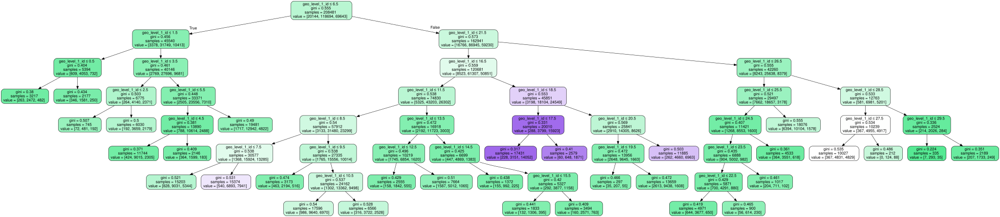

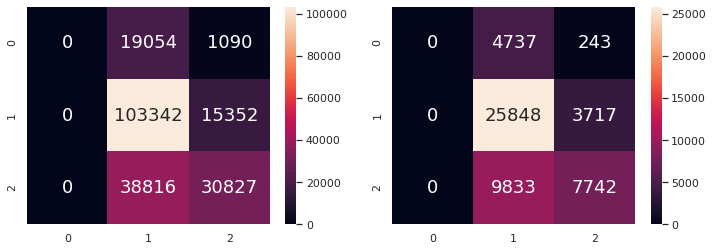

In [0]:
# Import essential models and functions from sklearn
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.tree import export_graphviz
import graphviz
from sklearn.metrics import classification_report

# Extract Response and Predictors
yui_land = pd.DataFrame(df3['damage_grade'])
Xui_land = pd.DataFrame(numericdata['geo_level_1_id'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X_train, X_test, y_train, y_test = train_test_split(Xui_land, yui_land, test_size = no)

#Best number for depth of decision trees
from sklearn.model_selection import GridSearchCV
tree_params = {'max_depth': [2,4,None],
               'criterion': ['gini', 'entropy'],
               'max_features': ['auto', 'sqrt', 'log2']}
locally_best_tree = GridSearchCV(DecisionTreeClassifier(),
                                 tree_params)                  

locally_best_tree.fit(X_train, y_train)
print("Best parameters:", locally_best_tree.best_params_)


# Decision Tree using Train Data
dectree = DecisionTreeClassifier(max_depth = locally_best_tree.best_params_['max_depth'],
                                 criterion = locally_best_tree.best_params_['criterion'],
                                 max_features = locally_best_tree.best_params_['max_features'])  # create the decision tree object
# train the decision tree model
dectree.fit(X_train, y_train)                   

# Predict Response corresponding to Predictors
y_train_pred = dectree.predict(X_train)
y_test_pred = dectree.predict(X_test)

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", dectree.score(X_train, y_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", dectree.score(X_test, y_test))
print()

#Classification Metrics
print(classification_report(y_train, y_train_pred))
print(classification_report(y_test, y_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y_train, y_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y_test, y_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

# Plot the Decision Tree
treedot = export_graphviz(dectree,                                      # the model
                          feature_names = X_train.columns,              # the features 
                          out_file = None,                              # output file
                          filled = True,                                # node colors
                          rounded = True,                               # make pretty
                          special_characters = True)                    # postscript

graphviz.Source(treedot)




Train Size: 208481
Testing Size: 52120
Total Size: 260601
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.569620253164557

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.5660782808902532

Accuracy: 0.5660782808902532


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



              precision    recall  f1-score   support

           1       0.00      0.00      0.00     20065
           2       0.57      1.00      0.73    118755
           3       0.00      0.00      0.00     69661

    accuracy                           0.57    208481
   macro avg       0.19      0.33      0.24    208481
weighted avg       0.32      0.57      0.41    208481

              precision    recall  f1-score   support

           1       0.00      0.00      0.00      5059
           2       0.57      1.00      0.72     29504
           3       0.00      0.00      0.00     17557

    accuracy                           0.57     52120
   macro avg       0.19      0.33      0.24     52120
weighted avg       0.32      0.57      0.41     52120



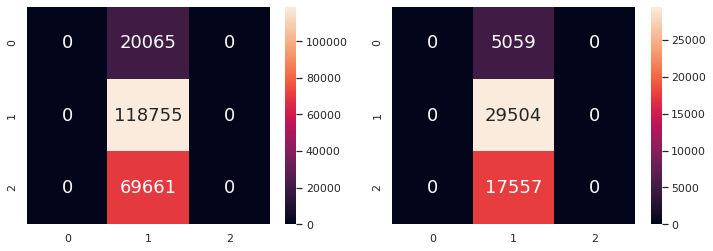

In [0]:
#Import scikit-learn metrics module for accuracy calculation
from sklearn.naive_bayes import GaussianNB
from sklearn import metrics
from sklearn.metrics import classification_report


# Extract Response and Predictors
ylasty = pd.DataFrame(df3['damage_grade'])
Xlasty = pd.DataFrame(numericdata['geo_level_1_id'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X_train, X_test, y_train, y_test = train_test_split(Xlasty, ylasty, test_size = no)


#Create a Gaussian Classifier and #rain the model using the training sets
gnb = GaussianNB()
gnb.fit(X_train, y_train.values.ravel())



#Predict the response for train & test dataset
y_train_pred = gnb.predict(X_train)
y_test_pred = gnb.predict(X_test)
 

#Import scikit-learn metrics module for accuracy calculation
from sklearn import metrics

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", gnb.score(X_train, y_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", gnb.score(X_test, y_test))
print()


# Model Accuracy, how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, y_test_pred))
print(classification_report(y_train, y_train_pred))
print(classification_report(y_test, y_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y_train, y_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y_test, y_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])


Train Size: 208481
Testing Size: 52120
Total Size: 260601
kvalue:    Accuracy Score 
1         0.44290099769762087
kvalue:    Accuracy Score 
2         0.476880276285495
kvalue:    Accuracy Score 
3         0.5596891788181121
kvalue:    Accuracy Score 
4         0.6324059861857253
kvalue:    Accuracy Score 
5         0.6210283960092096
kvalue:    Accuracy Score 
6         0.5797198772064467
kvalue:    Accuracy Score 
7         0.6079240214888718
kvalue:    Accuracy Score 
8         0.6220260936300844
kvalue:    Accuracy Score 
9         0.6086914811972371
kvalue:    Accuracy Score 
10         0.622256331542594
kvalue:    Accuracy Score 
11         0.600729086722947
kvalue:    Accuracy Score 
12         0.6171335379892555
kvalue:    Accuracy Score 
13         0.609976976208749
kvalue:    Accuracy Score 
14         0.623541826554106
kvalue:    Accuracy Score 
15         0.6086531082118188
kvalue:    Accuracy Score 
16         0.623541826554106
kvalue:    Accuracy Score 
17         0.6233

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  36 out of  36 | elapsed:  2.4min finished


Best params: {'metric': 'euclidean', 'n_neighbors': 11, 'weights': 'uniform'}

Accuracy score for the new selected train data 0.6006974256646889
Accuracy score for the new selected test data: 0.600729086722947

Classsification Metrics for Train Data:



/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



              precision    recall  f1-score   support

           1       0.00      0.00      0.00     20155
           2       0.63      0.75      0.69    118599
           3       0.53      0.52      0.52     69727

    accuracy                           0.60    208481
   macro avg       0.39      0.42      0.40    208481
weighted avg       0.54      0.60      0.57    208481


Classsification Metrics for Test Data:

              precision    recall  f1-score   support

           1       0.00      0.00      0.00      4969
           2       0.63      0.75      0.69     29660
           3       0.53      0.51      0.52     17491

    accuracy                           0.60     52120
   macro avg       0.39      0.42      0.40     52120
weighted avg       0.54      0.60      0.57     52120




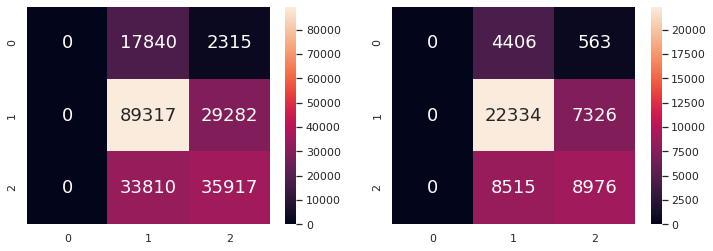

In [0]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn import metrics

# Extract Response and Predictors
ylasty = pd.DataFrame(df3['damage_grade'])
Xlasty = pd.DataFrame(numtrain['geo_level_1_id'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X_train, X_test, y_train, y_test = train_test_split(Xlasty, ylasty, test_size = no)


k_range = range(1,26)
scores = {}
scoress_list = []
for k in k_range:
  knn = KNeighborsClassifier(n_neighbors=k, weights="distance", algorithm="auto",n_jobs=-1)
  knn.fit(X_train,y_train.values.ravel())
  y_pred=knn.predict(X_test)
  scores[k] = metrics.accuracy_score(y_test,y_pred)
  scoress_list.append(metrics.accuracy_score(y_test,y_pred))
  print("kvalue:"+ "    Accuracy Score ")
  print(k,"       ", scoress_list[k-1])




from sklearn.model_selection import GridSearchCV
grid_params = {'n_neighbors':[7,9,11],
               'weights':['uniform','distance'],
               'metric':['euclidean','manhattan']}
knn_grid = GridSearchCV(KNeighborsClassifier(),grid_params,verbose = 1,cv=3,n_jobs=-1)
knn_grid_results = knn_grid.fit(X_train, y_train.values.ravel())

print("Best params:", knn_grid_results.best_params_)

# Create a new random forest classifier for the most important features
knn_new = KNeighborsClassifier(metric = knn_grid_results.best_params_['metric'],
                              n_neighbors = knn_grid_results.best_params_['n_neighbors'],
                              weights = knn_grid_results.best_params_['weights'],
                              algorithm = 'auto',n_jobs=-1)
# Train the new classifier on the new dataset containing the most important features
knn_new.fit(X_train, y_train.values.ravel())


# Apply The Full Featured Classifier To The Test Data
y_train_pred= knn_new.predict(X_train)


# Apply The Full Featured Classifier To The Test Data
y_test_pred = knn_new.predict(X_test)



print()
# View The Accuracy Of Our Limited Feature (2 Features) Model
print("Accuracy score for the new selected train data",metrics.accuracy_score(y_train, y_train_pred))
print("Accuracy score for the new selected test data:",metrics.accuracy_score(y_test, y_test_pred))
print()

from sklearn.metrics import classification_report

print("Classsification Metrics for Train Data:")
print()
print(classification_report(y_train, y_train_pred))
print()
print("Classsification Metrics for Test Data:")
print()
print(classification_report(y_test, y_test_pred))
print()

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y_train, y_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y_test, y_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

[Text(0, 0.5, 'Testing Accuracy'), Text(0.5, 0, 'Value for K for KNN')]

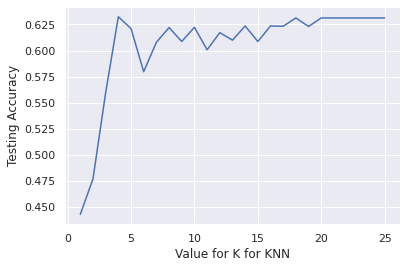

In [0]:
#KNN k_value vs Accuracy
chakiri = sb.lineplot(x = k_range, y = scoress_list)
chakiri.set(xlabel = "Value for K for KNN" , ylabel = "Testing Accuracy")

In [0]:
# geo_level_2_id

Train Size: 208481
Testing Size: 52120
Total Size: 260601
Best parameters: {'criterion': 'gini', 'max_depth': None, 'max_features': 'auto'}
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.6951472796082137

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.6940905602455871

              precision    recall  f1-score   support

           1       0.55      0.25      0.35     20092
           2       0.70      0.85      0.76    118658
           3       0.72      0.56      0.63     69731

    accuracy                           0.70    208481
   macro avg       0.66      0.55      0.58    208481
weighted avg       0.69      0.70      0.68    208481

              precision    recall  f1-score   support

           1       0.56      0.26      0.36      5032
           2       0.70      0.85      0.76     29601
           3       0.72      0.56      0.63     17487

    accuracy                           0.69     52120
   macro avg       0.66      0.56 

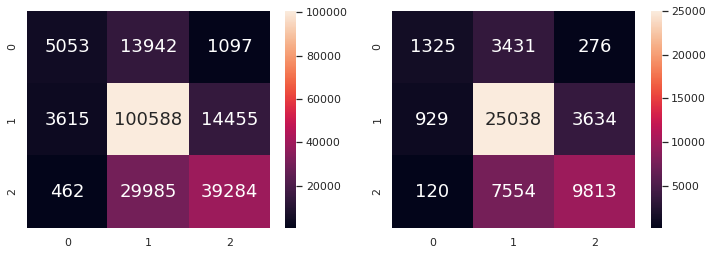

In [0]:
# Import essential models and functions from sklearn
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.tree import export_graphviz
import graphviz
from sklearn.metrics import classification_report

# Extract Response and Predictors
yui_land = pd.DataFrame(df3['damage_grade'])
Xui_land = pd.DataFrame(numericdata['geo_level_2_id'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X_train, X_test, y_train, y_test = train_test_split(Xui_land, yui_land, test_size = no)

#Best number for depth of decision trees
from sklearn.model_selection import GridSearchCV
tree_params = {'max_depth': [2,4,None],
               'criterion': ['gini', 'entropy'],
               'max_features': ['auto', 'sqrt', 'log2']}
locally_best_tree = GridSearchCV(DecisionTreeClassifier(),
                                 tree_params)                  

locally_best_tree.fit(X_train, y_train)
print("Best parameters:", locally_best_tree.best_params_)


# Decision Tree using Train Data
dectree = DecisionTreeClassifier(max_depth = locally_best_tree.best_params_['max_depth'],
                                 criterion = locally_best_tree.best_params_['criterion'],
                                 max_features = locally_best_tree.best_params_['max_features'])  # create the decision tree object
# train the decision tree model
dectree.fit(X_train, y_train)                   

# Predict Response corresponding to Predictors
y_train_pred = dectree.predict(X_train)
y_test_pred = dectree.predict(X_test)

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", dectree.score(X_train, y_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", dectree.score(X_test, y_test))
print()

#Classification Metrics
print(classification_report(y_train, y_train_pred))
print(classification_report(y_test, y_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y_train, y_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y_test, y_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

# Plot the Decision Tree
treedot = export_graphviz(dectree,                                      # the model
                          feature_names = X_train.columns,              # the features 
                          out_file = None,                              # output file
                          filled = True,                                # node colors
                          rounded = True,                               # make pretty
                          special_characters = True)                    # postscript

graphviz.Source(treedot)




Train Size: 208481
Testing Size: 52120
Total Size: 260601
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.5690062883428226

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.5685341519570223

Accuracy: 0.5685341519570223


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



              precision    recall  f1-score   support

           1       0.00      0.00      0.00     20085
           2       0.57      1.00      0.73    118627
           3       0.00      0.00      0.00     69769

    accuracy                           0.57    208481
   macro avg       0.19      0.33      0.24    208481
weighted avg       0.32      0.57      0.41    208481

              precision    recall  f1-score   support

           1       0.00      0.00      0.00      5039
           2       0.57      1.00      0.72     29632
           3       0.00      0.00      0.00     17449

    accuracy                           0.57     52120
   macro avg       0.19      0.33      0.24     52120
weighted avg       0.32      0.57      0.41     52120



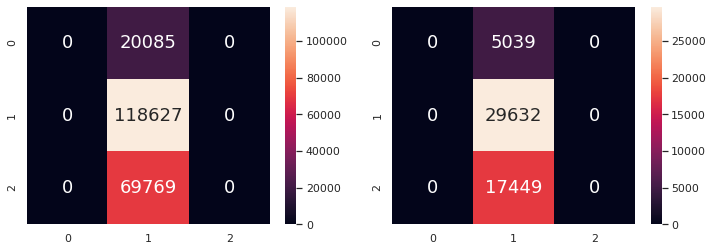

In [0]:
#Import scikit-learn metrics module for accuracy calculation
from sklearn.naive_bayes import GaussianNB
from sklearn import metrics
from sklearn.metrics import classification_report


# Extract Response and Predictors
ylasty = pd.DataFrame(df3['damage_grade'])
Xlasty = pd.DataFrame(numericdata["geo_level_2_id"])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X_train, X_test, y_train, y_test = train_test_split(Xlasty, ylasty, test_size = no)


#Create a Gaussian Classifier and #rain the model using the training sets
gnb = GaussianNB()
gnb.fit(X_train, y_train.values.ravel())



#Predict the response for train & test dataset
y_train_pred = gnb.predict(X_train)
y_test_pred = gnb.predict(X_test)
 

#Import scikit-learn metrics module for accuracy calculation
from sklearn import metrics

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", gnb.score(X_train, y_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", gnb.score(X_test, y_test))
print()


# Model Accuracy, how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, y_test_pred))
print(classification_report(y_train, y_train_pred))
print(classification_report(y_test, y_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y_train, y_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y_test, y_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

Train Size: 208481
Testing Size: 52120
Total Size: 260601
kvalue:    Accuracy Score 
1         0.5884881043745204
kvalue:    Accuracy Score 
2         0.5889102072141212
kvalue:    Accuracy Score 
3         0.6213161933998466
kvalue:    Accuracy Score 
4         0.6327129700690713
kvalue:    Accuracy Score 
5         0.6477743668457406
kvalue:    Accuracy Score 
6         0.6560437452033768
kvalue:    Accuracy Score 
7         0.6622601688411358
kvalue:    Accuracy Score 
8         0.6621066768994628
kvalue:    Accuracy Score 
9         0.6697429009976976
kvalue:    Accuracy Score 
10         0.6770913277052955
kvalue:    Accuracy Score 
11         0.6767651573292403
kvalue:    Accuracy Score 
12         0.6757099002302379
kvalue:    Accuracy Score 
13         0.673983115886416
kvalue:    Accuracy Score 
14         0.6774366845740598
kvalue:    Accuracy Score 
15         0.6792594013814275
kvalue:    Accuracy Score 
16         0.6828472755180353
kvalue:    Accuracy Score 
17         0.

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  36 out of  36 | elapsed:   22.2s finished


Best params: {'metric': 'euclidean', 'n_neighbors': 11, 'weights': 'distance'}

Accuracy score for the new selected train data 0.6785366532201975
Accuracy score for the new selected test data: 0.6767651573292403

Classsification Metrics for Train Data:

              precision    recall  f1-score   support

           1       0.48      0.35      0.40     20145
           2       0.70      0.81      0.75    118562
           3       0.69      0.55      0.61     69774

    accuracy                           0.68    208481
   macro avg       0.62      0.57      0.59    208481
weighted avg       0.67      0.68      0.67    208481


Classsification Metrics for Test Data:

              precision    recall  f1-score   support

           1       0.47      0.35      0.40      4979
           2       0.70      0.80      0.75     29697
           3       0.69      0.55      0.61     17444

    accuracy                           0.68     52120
   macro avg       0.62      0.57      0.59     5212

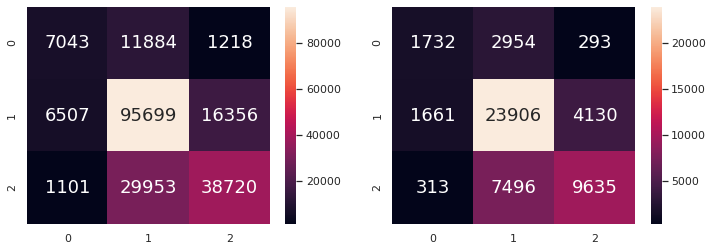

In [0]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn import metrics

# Extract Response and Predictors
ylasty = pd.DataFrame(df3['damage_grade'])
Xlasty = pd.DataFrame(numtrain['geo_level_2_id'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X_train, X_test, y_train, y_test = train_test_split(Xlasty, ylasty, test_size = no)


k_range = range(1,26)
scores = {}
scoresss_list = []
for k in k_range:
  knn = KNeighborsClassifier(n_neighbors=k, weights="distance", algorithm="auto",n_jobs=-1)
  knn.fit(X_train,y_train.values.ravel())
  y_pred=knn.predict(X_test)
  scores[k] = metrics.accuracy_score(y_test,y_pred)
  scoresss_list.append(metrics.accuracy_score(y_test,y_pred))
  print("kvalue:"+ "    Accuracy Score ")
  print(k,"       ", scoresss_list[k-1])




from sklearn.model_selection import GridSearchCV
grid_params = {'n_neighbors':[7,9,11],
               'weights':['uniform','distance'],
               'metric':['euclidean','manhattan']}
knn_grid = GridSearchCV(KNeighborsClassifier(),grid_params,verbose = 1,cv=3,n_jobs=-1)
knn_grid_results = knn_grid.fit(X_train, y_train.values.ravel())

print("Best params:", knn_grid_results.best_params_)

# Create a new random forest classifier for the most important features
knn_new = KNeighborsClassifier(metric = knn_grid_results.best_params_['metric'],
                              n_neighbors = knn_grid_results.best_params_['n_neighbors'],
                              weights = knn_grid_results.best_params_['weights'],
                              algorithm = 'auto',n_jobs=-1)
# Train the new classifier on the new dataset containing the most important features
knn_new.fit(X_train, y_train.values.ravel())


# Apply The Full Featured Classifier To The Test Data
y_train_pred= knn_new.predict(X_train)


# Apply The Full Featured Classifier To The Test Data
y_test_pred = knn_new.predict(X_test)



print()
# View The Accuracy Of Our Limited Feature (2 Features) Model
print("Accuracy score for the new selected train data",metrics.accuracy_score(y_train, y_train_pred))
print("Accuracy score for the new selected test data:",metrics.accuracy_score(y_test, y_test_pred))
print()

from sklearn.metrics import classification_report

print("Classsification Metrics for Train Data:")
print()
print(classification_report(y_train, y_train_pred))
print()
print("Classsification Metrics for Test Data:")
print()
print(classification_report(y_test, y_test_pred))
print()

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y_train, y_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y_test, y_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

[Text(0, 0.5, 'Testing Accuracy'), Text(0.5, 0, 'Value for K for KNN')]

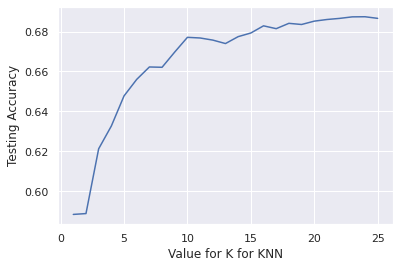

In [0]:
#KNN k_value vs Accuracy
chaikiri = sb.lineplot(x = k_range, y = scoresss_list)
chaikiri.set(xlabel = "Value for K for KNN" , ylabel = "Testing Accuracy")

In [0]:
#geo_level_3_id

Train Size: 208481
Testing Size: 52120
Total Size: 260601
Best parameters: {'criterion': 'gini', 'max_depth': None, 'max_features': 'auto'}
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.7363356852662832

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.7155410590943976

              precision    recall  f1-score   support

           1       0.61      0.42      0.50     20123
           2       0.74      0.85      0.79    118614
           3       0.75      0.63      0.69     69744

    accuracy                           0.74    208481
   macro avg       0.70      0.63      0.66    208481
weighted avg       0.73      0.74      0.73    208481

              precision    recall  f1-score   support

           1       0.56      0.40      0.47      5001
           2       0.73      0.83      0.78     29645
           3       0.73      0.61      0.66     17474

    accuracy                           0.72     52120
   macro avg       0.67      0.61 

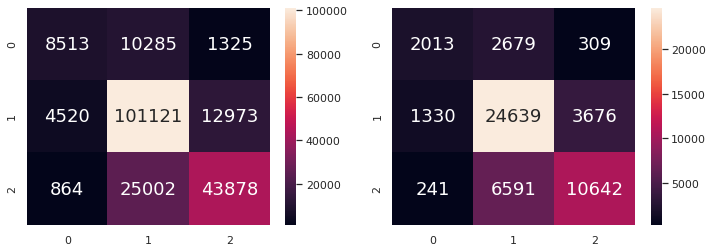

In [0]:
# Import essential models and functions from sklearn
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.tree import export_graphviz
import graphviz
from sklearn.metrics import classification_report

# Extract Response and Predictors
yui_land = pd.DataFrame(df3['damage_grade'])
Xui_land = pd.DataFrame(numericdata['geo_level_3_id'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X_train, X_test, y_train, y_test = train_test_split(Xui_land, yui_land, test_size = no)

#Best number for depth of decision trees
from sklearn.model_selection import GridSearchCV
tree_params = {'max_depth': [2,4,None],
               'criterion': ['gini', 'entropy'],
               'max_features': ['auto', 'sqrt', 'log2']}
locally_best_tree = GridSearchCV(DecisionTreeClassifier(),
                                 tree_params)                  

locally_best_tree.fit(X_train, y_train)
print("Best parameters:", locally_best_tree.best_params_)


# Decision Tree using Train Data
dectree = DecisionTreeClassifier(max_depth = locally_best_tree.best_params_['max_depth'],
                                 criterion = locally_best_tree.best_params_['criterion'],
                                 max_features = locally_best_tree.best_params_['max_features'])  # create the decision tree object
# train the decision tree model
dectree.fit(X_train, y_train)                   

# Predict Response corresponding to Predictors
y_train_pred = dectree.predict(X_train)
y_test_pred = dectree.predict(X_test)

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", dectree.score(X_train, y_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", dectree.score(X_test, y_test))
print()

#Classification Metrics
print(classification_report(y_train, y_train_pred))
print(classification_report(y_test, y_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y_train, y_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y_test, y_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

# Plot the Decision Tree
treedot = export_graphviz(dectree,                                      # the model
                          feature_names = X_train.columns,              # the features 
                          out_file = None,                              # output file
                          filled = True,                                # node colors
                          rounded = True,                               # make pretty
                          special_characters = True)                    # postscript

graphviz.Source(treedot)




Train Size: 208481
Testing Size: 52120
Total Size: 260601
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.5698025239710094

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.5653491941673062

Accuracy: 0.5653491941673062


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



              precision    recall  f1-score   support

           1       0.00      0.00      0.00     20145
           2       0.57      1.00      0.73    118793
           3       0.00      0.00      0.00     69543

    accuracy                           0.57    208481
   macro avg       0.19      0.33      0.24    208481
weighted avg       0.32      0.57      0.41    208481

              precision    recall  f1-score   support

           1       0.00      0.00      0.00      4979
           2       0.57      1.00      0.72     29466
           3       0.00      0.00      0.00     17675

    accuracy                           0.57     52120
   macro avg       0.19      0.33      0.24     52120
weighted avg       0.32      0.57      0.41     52120



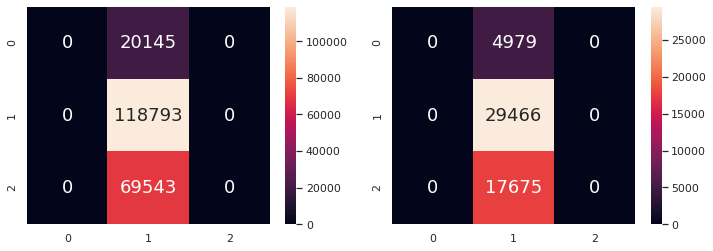

In [0]:
#Import scikit-learn metrics module for accuracy calculation
from sklearn.naive_bayes import GaussianNB
from sklearn import metrics
from sklearn.metrics import classification_report


# Extract Response and Predictors
ylasty = pd.DataFrame(df3['damage_grade'])
Xlasty = pd.DataFrame(numericdata['geo_level_3_id'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X_train, X_test, y_train, y_test = train_test_split(Xlasty, ylasty, test_size = no)


#Create a Gaussian Classifier and #rain the model using the training sets
gnb = GaussianNB()
gnb.fit(X_train, y_train.values.ravel())



#Predict the response for train & test dataset
y_train_pred = gnb.predict(X_train)
y_test_pred = gnb.predict(X_test)
 

#Import scikit-learn metrics module for accuracy calculation
from sklearn import metrics

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", gnb.score(X_train, y_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", gnb.score(X_test, y_test))
print()


# Model Accuracy, how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, y_test_pred))
print(classification_report(y_train, y_train_pred))
print(classification_report(y_test, y_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y_train, y_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y_test, y_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

Train Size: 208481
Testing Size: 52120
Total Size: 260601
kvalue:    Accuracy Score 
1         0.6285303146584804
kvalue:    Accuracy Score 
2         0.6313123561013047
kvalue:    Accuracy Score 
3         0.6618956254796623
kvalue:    Accuracy Score 
4         0.6777628549501151
kvalue:    Accuracy Score 
5         0.6852455871066769
kvalue:    Accuracy Score 
6         0.6897735993860322
kvalue:    Accuracy Score 
7         0.6951266308518803
kvalue:    Accuracy Score 
8         0.6979854182655411
kvalue:    Accuracy Score 
9         0.6984650805832694
kvalue:    Accuracy Score 
10         0.7022256331542595
kvalue:    Accuracy Score 
11         0.7034919416730622
kvalue:    Accuracy Score 
12         0.7039907904834997
kvalue:    Accuracy Score 
13         0.7061588641596316
kvalue:    Accuracy Score 
14         0.7059861857252494
kvalue:    Accuracy Score 
15         0.7069838833461243
kvalue:    Accuracy Score 
16         0.7068687643898696
kvalue:    Accuracy Score 
17         0

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  36 out of  36 | elapsed:   19.6s finished


Best params: {'metric': 'euclidean', 'n_neighbors': 11, 'weights': 'distance'}

Accuracy score for the new selected train data 0.7259654356991764
Accuracy score for the new selected test data: 0.7034919416730622

Classsification Metrics for Train Data:

              precision    recall  f1-score   support

           1       0.57      0.43      0.49     20109
           2       0.74      0.84      0.78    118468
           3       0.74      0.62      0.68     69904

    accuracy                           0.73    208481
   macro avg       0.68      0.63      0.65    208481
weighted avg       0.72      0.73      0.72    208481


Classsification Metrics for Test Data:

              precision    recall  f1-score   support

           1       0.52      0.41      0.46      5015
           2       0.72      0.81      0.77     29791
           3       0.70      0.60      0.65     17314

    accuracy                           0.70     52120
   macro avg       0.65      0.61      0.62     5212

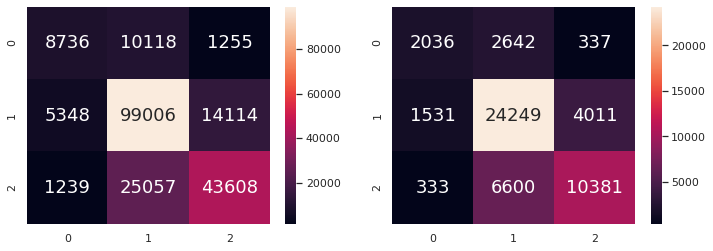

In [0]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn import metrics

# Extract Response and Predictors
ylasty = pd.DataFrame(df3['damage_grade'])
Xlasty = pd.DataFrame(numtrain['geo_level_3_id'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X_train, X_test, y_train, y_test = train_test_split(Xlasty, ylasty, test_size = no)


k_range = range(1,26)
scores = {}
score_list = []
for k in k_range:
  knn = KNeighborsClassifier(n_neighbors=k, weights="distance", algorithm="auto",n_jobs=-1)
  knn.fit(X_train,y_train.values.ravel())
  y_pred=knn.predict(X_test)
  scores[k] = metrics.accuracy_score(y_test,y_pred)
  score_list.append(metrics.accuracy_score(y_test,y_pred))
  print("kvalue:"+ "    Accuracy Score ")
  print(k,"       ", score_list[k-1])




from sklearn.model_selection import GridSearchCV
grid_params = {'n_neighbors':[7,9,11],
               'weights':['uniform','distance'],
               'metric':['euclidean','manhattan']}
knn_grid = GridSearchCV(KNeighborsClassifier(),grid_params,verbose = 1,cv=3,n_jobs=-1)
knn_grid_results = knn_grid.fit(X_train, y_train.values.ravel())

print("Best params:", knn_grid_results.best_params_)

# Create a new random forest classifier for the most important features
knn_new = KNeighborsClassifier(metric = knn_grid_results.best_params_['metric'],
                              n_neighbors = knn_grid_results.best_params_['n_neighbors'],
                              weights = knn_grid_results.best_params_['weights'],
                              algorithm = 'auto',n_jobs=-1)
# Train the new classifier on the new dataset containing the most important features
knn_new.fit(X_train, y_train.values.ravel())


# Apply The Full Featured Classifier To The Test Data
y_train_pred= knn_new.predict(X_train)


# Apply The Full Featured Classifier To The Test Data
y_test_pred = knn_new.predict(X_test)



print()
# View The Accuracy Of Our Limited Feature (2 Features) Model
print("Accuracy score for the new selected train data",metrics.accuracy_score(y_train, y_train_pred))
print("Accuracy score for the new selected test data:",metrics.accuracy_score(y_test, y_test_pred))
print()

from sklearn.metrics import classification_report

print("Classsification Metrics for Train Data:")
print()
print(classification_report(y_train, y_train_pred))
print()
print("Classsification Metrics for Test Data:")
print()
print(classification_report(y_test, y_test_pred))
print()

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y_train, y_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y_test, y_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

[Text(0, 0.5, 'Testing Accuracy'), Text(0.5, 0, 'Value for K for KNN')]

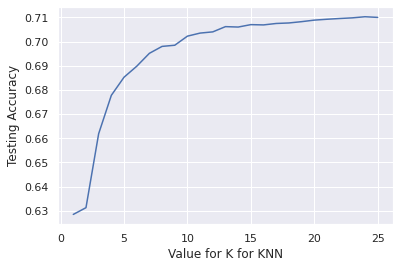

In [0]:
#KNN k_value vs Accuracy
chiakiri = sb.lineplot(x = k_range, y = score_list)
chiakiri.set(xlabel = "Value for K for KNN" , ylabel = "Testing Accuracy")

In [0]:
# count_floors_pre_eq

Train Size: 208481
Testing Size: 52120
Total Size: 260601
Best parameters: {'criterion': 'gini', 'max_depth': 2, 'max_features': 'auto'}
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.5692557115516522

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.5675364543361473



/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



              precision    recall  f1-score   support

           1       0.00      0.00      0.00     20117
           2       0.57      1.00      0.73    118679
           3       0.00      0.00      0.00     69685

    accuracy                           0.57    208481
   macro avg       0.19      0.33      0.24    208481
weighted avg       0.32      0.57      0.41    208481

              precision    recall  f1-score   support

           1       0.00      0.00      0.00      5007
           2       0.57      1.00      0.72     29580
           3       0.00      0.00      0.00     17533

    accuracy                           0.57     52120
   macro avg       0.19      0.33      0.24     52120
weighted avg       0.32      0.57      0.41     52120



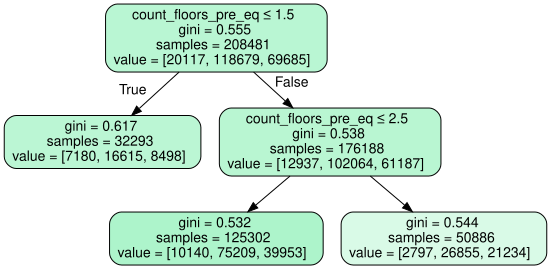

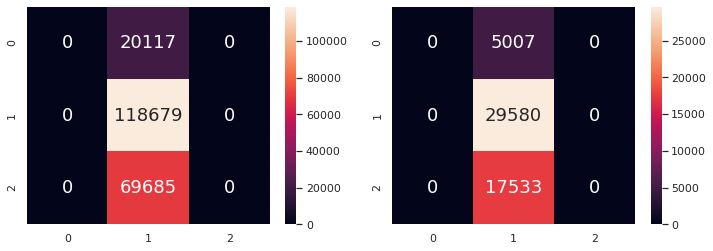

In [0]:
# Import essential models and functions from sklearn
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.tree import export_graphviz
import graphviz
from sklearn.metrics import classification_report

# Extract Response and Predictors
yui_land = pd.DataFrame(df3['damage_grade'])
Xui_land = pd.DataFrame(numericdata['count_floors_pre_eq'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X_train, X_test, y_train, y_test = train_test_split(Xui_land, yui_land, test_size = no)

#Best number for depth of decision trees
from sklearn.model_selection import GridSearchCV
tree_params = {'max_depth': [2,4,None],
               'criterion': ['gini', 'entropy'],
               'max_features': ['auto', 'sqrt', 'log2']}
locally_best_tree = GridSearchCV(DecisionTreeClassifier(),
                                 tree_params)                  

locally_best_tree.fit(X_train, y_train)
print("Best parameters:", locally_best_tree.best_params_)


# Decision Tree using Train Data
dectree = DecisionTreeClassifier(max_depth = locally_best_tree.best_params_['max_depth'],
                                 criterion = locally_best_tree.best_params_['criterion'],
                                 max_features = locally_best_tree.best_params_['max_features'])  # create the decision tree object
# train the decision tree model
dectree.fit(X_train, y_train)                   

# Predict Response corresponding to Predictors
y_train_pred = dectree.predict(X_train)
y_test_pred = dectree.predict(X_test)

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", dectree.score(X_train, y_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", dectree.score(X_test, y_test))
print()

#Classification Metrics
print(classification_report(y_train, y_train_pred))
print(classification_report(y_test, y_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y_train, y_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y_test, y_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

# Plot the Decision Tree
treedot = export_graphviz(dectree,                                      # the model
                          feature_names = X_train.columns,              # the features 
                          out_file = None,                              # output file
                          filled = True,                                # node colors
                          rounded = True,                               # make pretty
                          special_characters = True)                    # postscript

graphviz.Source(treedot)




Train Size: 208481
Testing Size: 52120
Total Size: 260601
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.5691214067468978

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.5677858787413661

Accuracy: 0.5677858787413661


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



              precision    recall  f1-score   support

           1       0.28      0.00      0.00     20082
           2       0.57      1.00      0.73    118663
           3       0.00      0.00      0.00     69736

    accuracy                           0.57    208481
   macro avg       0.28      0.33      0.24    208481
weighted avg       0.35      0.57      0.41    208481

              precision    recall  f1-score   support

           1       0.20      0.00      0.00      5042
           2       0.57      1.00      0.72     29596
           3       0.00      0.00      0.00     17482

    accuracy                           0.57     52120
   macro avg       0.26      0.33      0.24     52120
weighted avg       0.34      0.57      0.41     52120



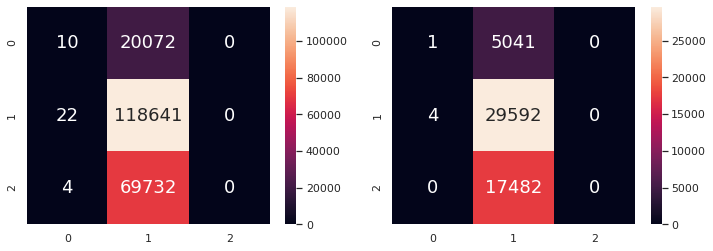

In [0]:
#Import scikit-learn metrics module for accuracy calculation
from sklearn.naive_bayes import GaussianNB
from sklearn import metrics
from sklearn.metrics import classification_report


# Extract Response and Predictors
ylasty = pd.DataFrame(df3['damage_grade'])
Xlasty = pd.DataFrame(numericdata['count_floors_pre_eq'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X_train, X_test, y_train, y_test = train_test_split(Xlasty, ylasty, test_size = no)


#Create a Gaussian Classifier and #rain the model using the training sets
gnb = GaussianNB()
gnb.fit(X_train, y_train.values.ravel())



#Predict the response for train & test dataset
y_train_pred = gnb.predict(X_train)
y_test_pred = gnb.predict(X_test)
 

#Import scikit-learn metrics module for accuracy calculation
from sklearn import metrics

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", gnb.score(X_train, y_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", gnb.score(X_test, y_test))
print()


# Model Accuracy, how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, y_test_pred))
print(classification_report(y_train, y_train_pred))
print(classification_report(y_test, y_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y_train, y_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y_test, y_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

In [0]:
#age

Train Size: 208481
Testing Size: 52120
Total Size: 260601
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.5697065919676133

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.5658096699923254

Train Data



/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



              precision    recall  f1-score   support

           1       0.00      0.00      0.00     20084
           2       0.57      1.00      0.73    118767
           3       0.59      0.00      0.00     69630

    accuracy                           0.57    208481
   macro avg       0.39      0.33      0.24    208481
weighted avg       0.52      0.57      0.41    208481


Test Data
              precision    recall  f1-score   support

           1       0.00      0.00      0.00      5040
           2       0.57      1.00      0.72     29492
           3       0.38      0.00      0.00     17588

    accuracy                           0.57     52120
   macro avg       0.31      0.33      0.24     52120
weighted avg       0.45      0.57      0.41     52120



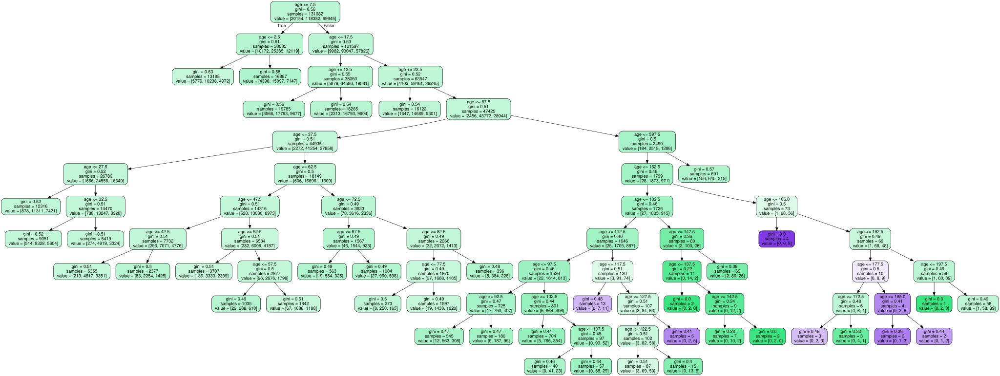

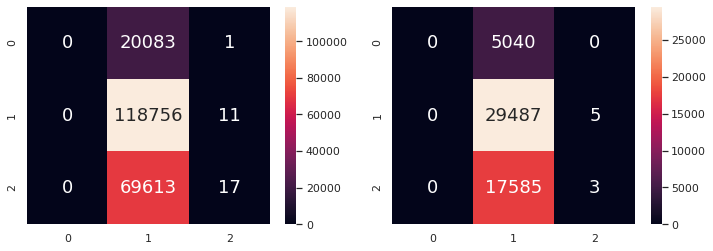

In [0]:
#Random Forest for Age



# Import essential models and functions from sklearn
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.tree import export_graphviz
import graphviz

# Extract Response and Predictors
y93sd = pd.DataFrame(df3['damage_grade'])
X93sd = pd.DataFrame(df3['age'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X93sd_train, X93sd_test, y93sd_train, y93sd_test = train_test_split(X93sd, y93sd, test_size = no)

# Decision Tree using Train Data
rfc = RandomForestClassifier(max_depth= None ,n_estimators=100)  # create the decision tree object
rfc.fit(X93sd_train, y93sd_train.values.ravel())                    # train the decision tree model
estimator = rfc.estimators_[5]
# Predict Response corresponding to Predictors
y93sd_train_pred = rfc.predict(X93sd_train)
y93sd_test_pred = rfc.predict(X93sd_test)

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", rfc.score(X93sd_train, y93sd_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", rfc.score(X93sd_test, y93sd_test))
print()

#Classification Metrics
from sklearn.metrics import classification_report
print("Train Data")
print()
print(classification_report(y93sd_train, y93sd_train_pred))
print()
print("Test Data")
print(classification_report(y93sd_test, y93sd_test_pred))
# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y93sd_train, y93sd_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y93sd_test, y93sd_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

# Plot the Decision Tree
treedot = export_graphviz(estimator, out_file=None, 
                feature_names = X93sd_train.columns,
                rounded = True, proportion = False, 
                precision = 2, filled = True)
graphviz.Source(treedot)

Train Size: 208481
Testing Size: 52120
Total Size: 260601
Best parameters: {'criterion': 'gini', 'max_depth': None, 'max_features': 'auto'}
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.5684402895227862

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.5708749040675365



/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



              precision    recall  f1-score   support

           1       0.00      0.00      0.00     20146
           2       0.57      1.00      0.72    118503
           3       0.59      0.00      0.00     69832

    accuracy                           0.57    208481
   macro avg       0.39      0.33      0.24    208481
weighted avg       0.52      0.57      0.41    208481

              precision    recall  f1-score   support

           1       0.00      0.00      0.00      4978
           2       0.57      1.00      0.73     29756
           3       0.25      0.00      0.00     17386

    accuracy                           0.57     52120
   macro avg       0.27      0.33      0.24     52120
weighted avg       0.41      0.57      0.41     52120



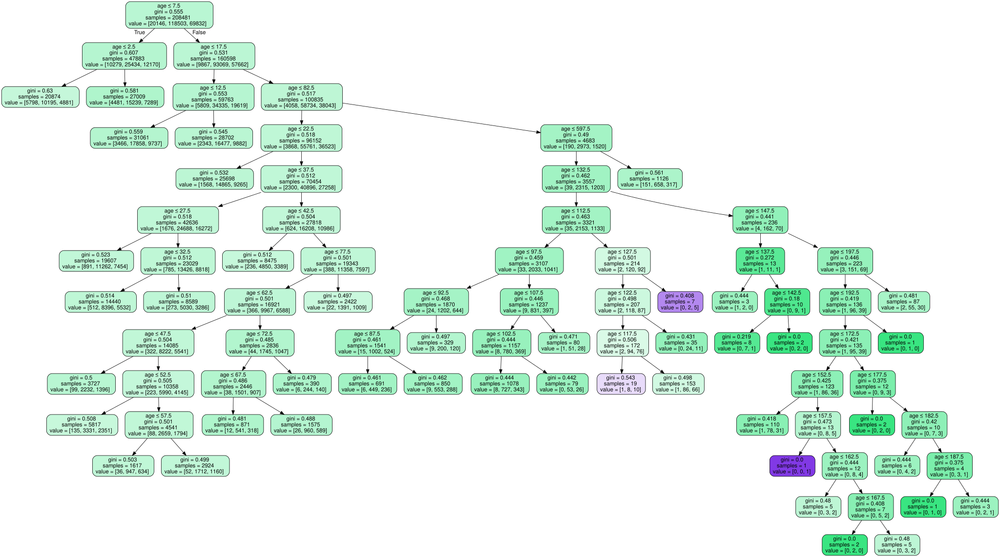

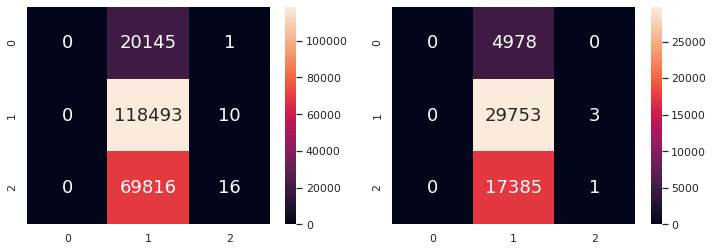

In [0]:
# Import essential models and functions from sklearn
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.tree import export_graphviz
import graphviz
from sklearn.metrics import classification_report

# Extract Response and Predictors
yui_land = pd.DataFrame(df3['damage_grade'])
Xui_land = pd.DataFrame(numericdata['age'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X_train, X_test, y_train, y_test = train_test_split(Xui_land, yui_land, test_size = no)

#Best number for depth of decision trees
from sklearn.model_selection import GridSearchCV
tree_params = {'max_depth': [2,4,None],
               'criterion': ['gini', 'entropy'],
               'max_features': ['auto', 'sqrt', 'log2']}
locally_best_tree = GridSearchCV(DecisionTreeClassifier(),
                                 tree_params)                  

locally_best_tree.fit(X_train, y_train)
print("Best parameters:", locally_best_tree.best_params_)


# Decision Tree using Train Data
dectree = DecisionTreeClassifier(max_depth = locally_best_tree.best_params_['max_depth'],
                                 criterion = locally_best_tree.best_params_['criterion'],
                                 max_features = locally_best_tree.best_params_['max_features'])  # create the decision tree object
# train the decision tree model
dectree.fit(X_train, y_train)                   

# Predict Response corresponding to Predictors
y_train_pred = dectree.predict(X_train)
y_test_pred = dectree.predict(X_test)

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", dectree.score(X_train, y_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", dectree.score(X_test, y_test))
print()

#Classification Metrics
print(classification_report(y_train, y_train_pred))
print(classification_report(y_test, y_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y_train, y_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y_test, y_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

# Plot the Decision Tree
treedot = export_graphviz(dectree,                                      # the model
                          feature_names = X_train.columns,              # the features 
                          out_file = None,                              # output file
                          filled = True,                                # node colors
                          rounded = True,                               # make pretty
                          special_characters = True)                    # postscript

graphviz.Source(treedot)




Train Size: 208481
Testing Size: 52120
Total Size: 260601
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.5656198886229441

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.5697429009976976

Accuracy: 0.5697429009976976


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



              precision    recall  f1-score   support

           1       0.13      0.01      0.01     20148
           2       0.57      0.99      0.72    118438
           3       0.00      0.00      0.00     69895

    accuracy                           0.57    208481
   macro avg       0.23      0.33      0.25    208481
weighted avg       0.33      0.57      0.41    208481

              precision    recall  f1-score   support

           1       0.14      0.01      0.01      4976
           2       0.57      0.99      0.73     29821
           3       0.00      0.00      0.00     17323

    accuracy                           0.57     52120
   macro avg       0.24      0.33      0.25     52120
weighted avg       0.34      0.57      0.42     52120



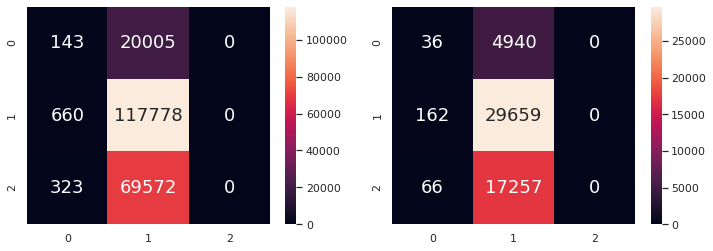

In [0]:
#Import scikit-learn metrics module for accuracy calculation
from sklearn.naive_bayes import GaussianNB
from sklearn import metrics
from sklearn.metrics import classification_report


# Extract Response and Predictors
ylasty = pd.DataFrame(df3['damage_grade'])
Xlasty = pd.DataFrame(numericdata['age'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X_train, X_test, y_train, y_test = train_test_split(Xlasty, ylasty, test_size = no)


#Create a Gaussian Classifier and #rain the model using the training sets
gnb = GaussianNB()
gnb.fit(X_train, y_train.values.ravel())



#Predict the response for train & test dataset
y_train_pred = gnb.predict(X_train)
y_test_pred = gnb.predict(X_test)
 

#Import scikit-learn metrics module for accuracy calculation
from sklearn import metrics

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", gnb.score(X_train, y_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", gnb.score(X_test, y_test))
print()


# Model Accuracy, how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, y_test_pred))
print(classification_report(y_train, y_train_pred))
print(classification_report(y_test, y_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y_train, y_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y_test, y_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

In [0]:
#area_percentage

Train Size: 208481
Testing Size: 52120
Total Size: 260601
Best parameters: {'criterion': 'gini', 'max_depth': 2, 'max_features': 'auto'}
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.568565001127201

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.5702993092862625



/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



              precision    recall  f1-score   support

           1       0.00      0.00      0.00     20072
           2       0.57      1.00      0.72    118535
           3       0.00      0.00      0.00     69874

    accuracy                           0.57    208481
   macro avg       0.19      0.33      0.24    208481
weighted avg       0.32      0.57      0.41    208481

              precision    recall  f1-score   support

           1       0.00      0.00      0.00      5052
           2       0.57      1.00      0.73     29724
           3       0.00      0.00      0.00     17344

    accuracy                           0.57     52120
   macro avg       0.19      0.33      0.24     52120
weighted avg       0.33      0.57      0.41     52120



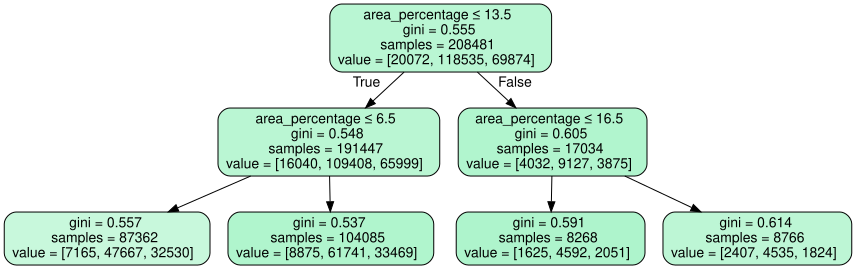

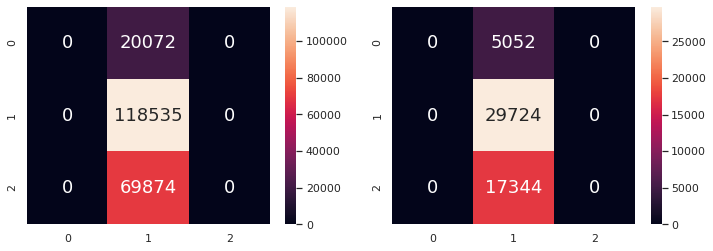

In [0]:
# Import essential models and functions from sklearn
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.tree import export_graphviz
import graphviz
from sklearn.metrics import classification_report

# Extract Response and Predictors
yui_land = pd.DataFrame(df3['damage_grade'])
Xui_land = pd.DataFrame(numericdata['area_percentage'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X_train, X_test, y_train, y_test = train_test_split(Xui_land, yui_land, test_size = no)

#Best number for depth of decision trees
from sklearn.model_selection import GridSearchCV
tree_params = {'max_depth': [2,4,None],
               'criterion': ['gini', 'entropy'],
               'max_features': ['auto', 'sqrt', 'log2']}
locally_best_tree = GridSearchCV(DecisionTreeClassifier(),
                                 tree_params)                  

locally_best_tree.fit(X_train, y_train)
print("Best parameters:", locally_best_tree.best_params_)


# Decision Tree using Train Data
dectree = DecisionTreeClassifier(max_depth = locally_best_tree.best_params_['max_depth'],
                                 criterion = locally_best_tree.best_params_['criterion'],
                                 max_features = locally_best_tree.best_params_['max_features'])  # create the decision tree object
# train the decision tree model
dectree.fit(X_train, y_train)                   

# Predict Response corresponding to Predictors
y_train_pred = dectree.predict(X_train)
y_test_pred = dectree.predict(X_test)

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", dectree.score(X_train, y_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", dectree.score(X_test, y_test))
print()

#Classification Metrics
print(classification_report(y_train, y_train_pred))
print(classification_report(y_test, y_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y_train, y_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y_test, y_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

# Plot the Decision Tree
treedot = export_graphviz(dectree,                                      # the model
                          feature_names = X_train.columns,              # the features 
                          out_file = None,                              # output file
                          filled = True,                                # node colors
                          rounded = True,                               # make pretty
                          special_characters = True)                    # postscript

graphviz.Source(treedot)




Train Size: 208481
Testing Size: 52120
Total Size: 260601
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.562032031695934

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.5649079048349962

Accuracy: 0.5649079048349962


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



              precision    recall  f1-score   support

           1       0.28      0.08      0.13     20124
           2       0.57      0.98      0.72    118479
           3       0.00      0.00      0.00     69878

    accuracy                           0.56    208481
   macro avg       0.28      0.35      0.28    208481
weighted avg       0.35      0.56      0.42    208481

              precision    recall  f1-score   support

           1       0.28      0.08      0.12      5000
           2       0.57      0.98      0.72     29780
           3       0.00      0.00      0.00     17340

    accuracy                           0.56     52120
   macro avg       0.28      0.35      0.28     52120
weighted avg       0.35      0.56      0.42     52120



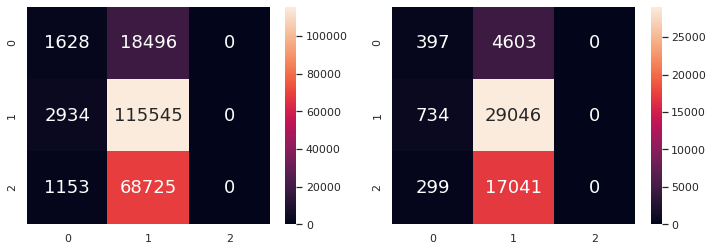

In [0]:
#Import scikit-learn metrics module for accuracy calculation
from sklearn.naive_bayes import GaussianNB
from sklearn import metrics
from sklearn.metrics import classification_report


# Extract Response and Predictors
ylasty = pd.DataFrame(df3['damage_grade'])
Xlasty = pd.DataFrame(numericdata['area_percentage'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X_train, X_test, y_train, y_test = train_test_split(Xlasty, ylasty, test_size = no)


#Create a Gaussian Classifier and #rain the model using the training sets
gnb = GaussianNB()
gnb.fit(X_train, y_train.values.ravel())



#Predict the response for train & test dataset
y_train_pred = gnb.predict(X_train)
y_test_pred = gnb.predict(X_test)
 

#Import scikit-learn metrics module for accuracy calculation
from sklearn import metrics

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", gnb.score(X_train, y_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", gnb.score(X_test, y_test))
print()


# Model Accuracy, how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, y_test_pred))
print(classification_report(y_train, y_train_pred))
print(classification_report(y_test, y_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y_train, y_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y_test, y_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

In [0]:
#height_percentage

Train Size: 208481
Testing Size: 52120
Total Size: 260601
Best parameters: {'criterion': 'gini', 'max_depth': None, 'max_features': 'auto'}
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.5691453897477468

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.5694742900997698

              precision    recall  f1-score   support

           1       0.46      0.01      0.02     20028
           2       0.57      1.00      0.73    118583
           3       0.90      0.00      0.00     69870

    accuracy                           0.57    208481
   macro avg       0.64      0.34      0.25    208481
weighted avg       0.67      0.57      0.41    208481

              precision    recall  f1-score   support

           1       0.39      0.01      0.02      5096
           2       0.57      1.00      0.73     29676
           3       0.89      0.00      0.00     17348

    accuracy                           0.57     52120
   macro avg       0.62      0.34 

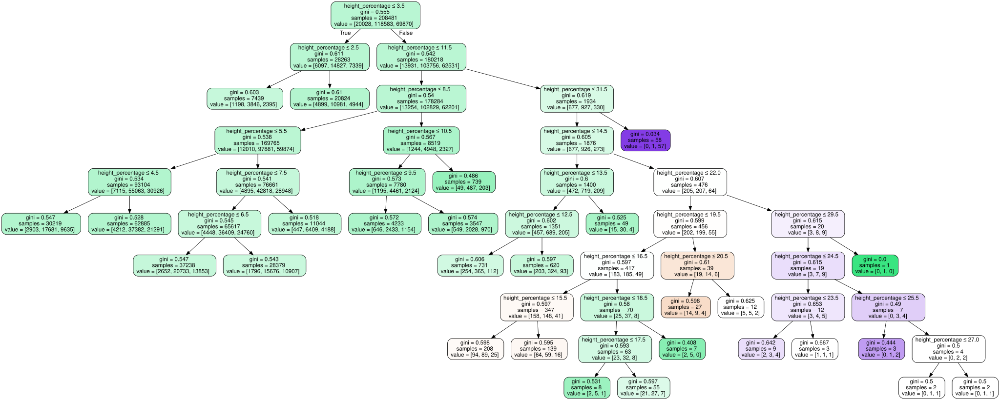

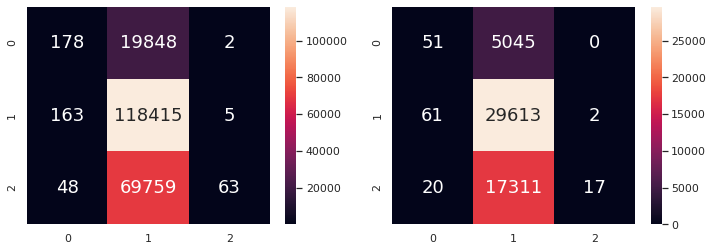

In [0]:
# Import essential models and functions from sklearn
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.tree import export_graphviz
import graphviz
from sklearn.metrics import classification_report

# Extract Response and Predictors
yui_land = pd.DataFrame(df3['damage_grade'])
Xui_land = pd.DataFrame(numericdata['height_percentage'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X_train, X_test, y_train, y_test = train_test_split(Xui_land, yui_land, test_size = no)

#Best number for depth of decision trees
from sklearn.model_selection import GridSearchCV
tree_params = {'max_depth': [2,4,None],
               'criterion': ['gini', 'entropy'],
               'max_features': ['auto', 'sqrt', 'log2']}
locally_best_tree = GridSearchCV(DecisionTreeClassifier(),
                                 tree_params)                  

locally_best_tree.fit(X_train, y_train)
print("Best parameters:", locally_best_tree.best_params_)


# Decision Tree using Train Data
dectree = DecisionTreeClassifier(max_depth = locally_best_tree.best_params_['max_depth'],
                                 criterion = locally_best_tree.best_params_['criterion'],
                                 max_features = locally_best_tree.best_params_['max_features'])  # create the decision tree object
# train the decision tree model
dectree.fit(X_train, y_train)                   

# Predict Response corresponding to Predictors
y_train_pred = dectree.predict(X_train)
y_test_pred = dectree.predict(X_test)

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", dectree.score(X_train, y_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", dectree.score(X_test, y_test))
print()

#Classification Metrics
print(classification_report(y_train, y_train_pred))
print(classification_report(y_test, y_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y_train, y_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y_test, y_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

# Plot the Decision Tree
treedot = export_graphviz(dectree,                                      # the model
                          feature_names = X_train.columns,              # the features 
                          out_file = None,                              # output file
                          filled = True,                                # node colors
                          rounded = True,                               # make pretty
                          special_characters = True)                    # postscript

graphviz.Source(treedot)




Train Size: 208481
Testing Size: 52120
Total Size: 260601
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.5677783586993539

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.5670567920184191

Accuracy: 0.5670567920184191


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



              precision    recall  f1-score   support

           1       0.34      0.03      0.06     20049
           2       0.57      0.99      0.72    118649
           3       0.00      0.00      0.00     69783

    accuracy                           0.57    208481
   macro avg       0.30      0.34      0.26    208481
weighted avg       0.36      0.57      0.42    208481

              precision    recall  f1-score   support

           1       0.36      0.03      0.06      5075
           2       0.57      0.99      0.72     29610
           3       0.00      0.00      0.00     17435

    accuracy                           0.57     52120
   macro avg       0.31      0.34      0.26     52120
weighted avg       0.36      0.57      0.42     52120



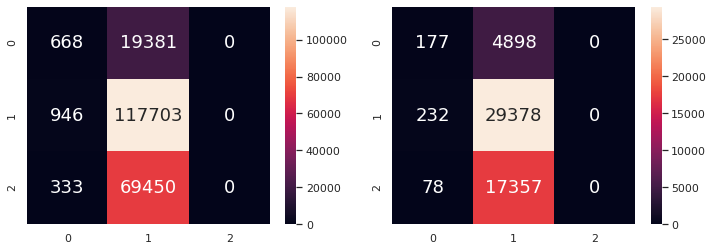

In [0]:
#Import scikit-learn metrics module for accuracy calculation
from sklearn.naive_bayes import GaussianNB
from sklearn import metrics
from sklearn.metrics import classification_report


# Extract Response and Predictors
ylasty = pd.DataFrame(df3['damage_grade'])
Xlasty = pd.DataFrame(numericdata['height_percentage'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X_train, X_test, y_train, y_test = train_test_split(Xlasty, ylasty, test_size = no)


#Create a Gaussian Classifier and #rain the model using the training sets
gnb = GaussianNB()
gnb.fit(X_train, y_train.values.ravel())



#Predict the response for train & test dataset
y_train_pred = gnb.predict(X_train)
y_test_pred = gnb.predict(X_test)
 

#Import scikit-learn metrics module for accuracy calculation
from sklearn import metrics

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", gnb.score(X_train, y_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", gnb.score(X_test, y_test))
print()


# Model Accuracy, how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, y_test_pred))
print(classification_report(y_train, y_train_pred))
print(classification_report(y_test, y_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y_train, y_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y_test, y_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

In [0]:
# has_superstructure_adobe_mud

Train Size: 208481
Testing Size: 52120
Total Size: 260601
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.5690974237460488

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.5681696085955488

              precision    recall  f1-score   support

           1       0.00      0.00      0.00      5000
           2       0.57      1.00      0.72     29613
           3       0.00      0.00      0.00     17507

    accuracy                           0.57     52120
   macro avg       0.19      0.33      0.24     52120
weighted avg       0.32      0.57      0.41     52120



/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


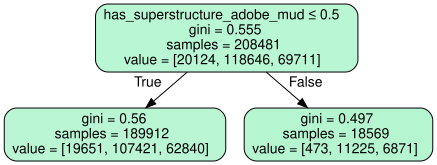

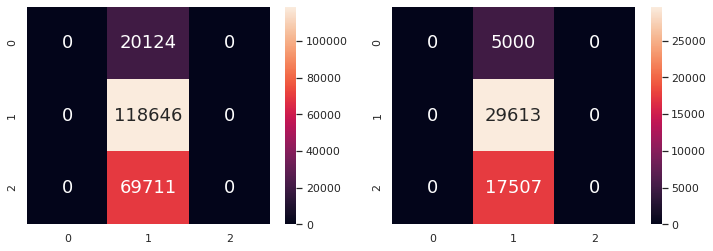

In [0]:
# Import essential models and functions from sklearn
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.tree import export_graphviz
import graphviz

# Extract Response and Predictors
y7 = pd.DataFrame(df3['damage_grade'])
X7 = pd.DataFrame(numtrain['has_superstructure_adobe_mud'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X7_train, X7_test, y7_train, y7_test = train_test_split(X7, y7, test_size = no)

# Decision Tree using Train Data
dectree = DecisionTreeClassifier(max_depth = 4)  # create the decision tree object
dectree.fit(X7_train, y7_train)                    # train the decision tree model

# Predict Response corresponding to Predictors
y7_train_pred = dectree.predict(X7_train)
y7_test_pred = dectree.predict(X7_test)

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", dectree.score(X7_train, y7_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", dectree.score(X7_test, y7_test))
print()

#Classification Metrics
from sklearn.metrics import classification_report

print(classification_report(y7_test, y7_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y7_train, y7_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y7_test, y7_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

# Plot the Decision Tree
treedot = export_graphviz(dectree,                                      # the model
                          feature_names = X7_train.columns,              # the features 
                          out_file = None,                              # output file
                          filled = True,                                # node colors
                          rounded = True,                               # make pretty
                          special_characters = True)                    # postscript

graphviz.Source(treedot)


Train Size: 208481
Testing Size: 52120
Total Size: 260601
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.5688144243360306

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.5693016116653876

Accuracy: 0.5693016116653876


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



              precision    recall  f1-score   support

           1       0.00      0.00      0.00     20159
           2       0.57      1.00      0.73    118587
           3       0.00      0.00      0.00     69735

    accuracy                           0.57    208481
   macro avg       0.19      0.33      0.24    208481
weighted avg       0.32      0.57      0.41    208481

              precision    recall  f1-score   support

           1       0.00      0.00      0.00      4965
           2       0.57      1.00      0.73     29672
           3       0.00      0.00      0.00     17483

    accuracy                           0.57     52120
   macro avg       0.19      0.33      0.24     52120
weighted avg       0.32      0.57      0.41     52120



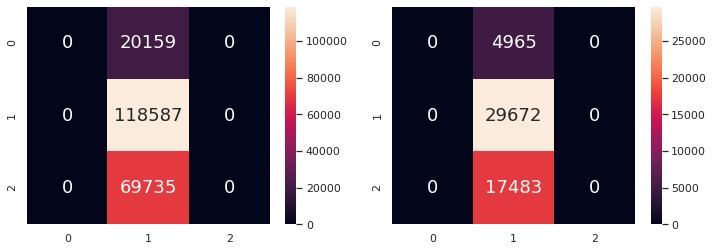

In [0]:
#Import scikit-learn metrics module for accuracy calculation
from sklearn.naive_bayes import GaussianNB
from sklearn import metrics
from sklearn.metrics import classification_report


# Extract Response and Predictors
ylasty = pd.DataFrame(df3['damage_grade'])
Xlasty = pd.DataFrame(numericdata['has_superstructure_adobe_mud'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X_train, X_test, y_train, y_test = train_test_split(Xlasty, ylasty, test_size = no)


#Create a Gaussian Classifier and #rain the model using the training sets
gnb = GaussianNB()
gnb.fit(X_train, y_train.values.ravel())



#Predict the response for train & test dataset
y_train_pred = gnb.predict(X_train)
y_test_pred = gnb.predict(X_test)
 

#Import scikit-learn metrics module for accuracy calculation
from sklearn import metrics

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", gnb.score(X_train, y_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", gnb.score(X_test, y_test))
print()


# Model Accuracy, how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, y_test_pred))
print(classification_report(y_train, y_train_pred))
print(classification_report(y_test, y_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y_train, y_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y_test, y_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

In [0]:
#has_superstructure_mud_mortar_stone

Train Size: 208481
Testing Size: 52120
Total Size: 260601
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.5691022203462186

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.5681504221028396

              precision    recall  f1-score   support

           1       0.00      0.00      0.00      4993
           2       0.57      1.00      0.72     29612
           3       0.00      0.00      0.00     17515

    accuracy                           0.57     52120
   macro avg       0.19      0.33      0.24     52120
weighted avg       0.32      0.57      0.41     52120



/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


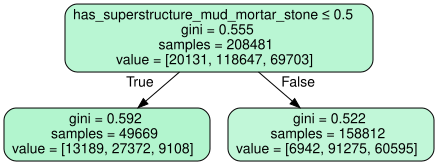

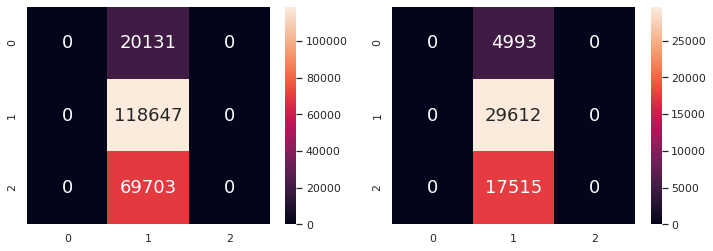

In [0]:
# Import essential models and functions from sklearn
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.tree import export_graphviz
import graphviz

# Extract Response and Predictors
y8 = pd.DataFrame(df3['damage_grade'])
X8 = pd.DataFrame(numtrain['has_superstructure_mud_mortar_stone'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X8_train, X8_test, y8_train, y8_test = train_test_split(X8, y8, test_size = no)

# Decision Tree using Train Data
dectree = DecisionTreeClassifier(max_depth = 4)  # create the decision tree object
dectree.fit(X8_train, y8_train)                    # train the decision tree model

# Predict Response corresponding to Predictors
y8_train_pred = dectree.predict(X8_train)
y8_test_pred = dectree.predict(X8_test)

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", dectree.score(X8_train, y8_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", dectree.score(X8_test, y8_test))
print()

#Classification Metrics
from sklearn.metrics import classification_report

print(classification_report(y8_test, y8_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y8_train, y8_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y8_test, y8_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

# Plot the Decision Tree
treedot = export_graphviz(dectree,                                      # the model
                          feature_names = X8_train.columns,              # the features 
                          out_file = None,                              # output file
                          filled = True,                                # node colors
                          rounded = True,                               # make pretty
                          special_characters = True)                    # postscript

graphviz.Source(treedot)


Train Size: 208481
Testing Size: 52120
Total Size: 260601
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.5685026453249936

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.5705487336914812

Accuracy: 0.5705487336914812


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



              precision    recall  f1-score   support

           1       0.00      0.00      0.00     20143
           2       0.57      1.00      0.72    118522
           3       0.00      0.00      0.00     69816

    accuracy                           0.57    208481
   macro avg       0.19      0.33      0.24    208481
weighted avg       0.32      0.57      0.41    208481

              precision    recall  f1-score   support

           1       0.00      0.00      0.00      4981
           2       0.57      1.00      0.73     29737
           3       0.00      0.00      0.00     17402

    accuracy                           0.57     52120
   macro avg       0.19      0.33      0.24     52120
weighted avg       0.33      0.57      0.41     52120



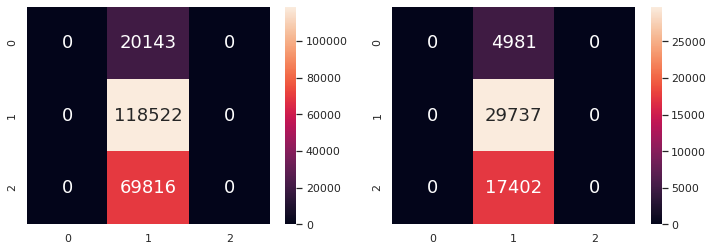

In [0]:
#Import scikit-learn metrics module for accuracy calculation
from sklearn.naive_bayes import GaussianNB
from sklearn import metrics
from sklearn.metrics import classification_report


# Extract Response and Predictors
ylasty = pd.DataFrame(df3['damage_grade'])
Xlasty = pd.DataFrame(numericdata['has_superstructure_mud_mortar_stone'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X_train, X_test, y_train, y_test = train_test_split(Xlasty, ylasty, test_size = no)


#Create a Gaussian Classifier and #rain the model using the training sets
gnb = GaussianNB()
gnb.fit(X_train, y_train.values.ravel())



#Predict the response for train & test dataset
y_train_pred = gnb.predict(X_train)
y_test_pred = gnb.predict(X_test)
 

#Import scikit-learn metrics module for accuracy calculation
from sklearn import metrics

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", gnb.score(X_train, y_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", gnb.score(X_test, y_test))
print()


# Model Accuracy, how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, y_test_pred))
print(classification_report(y_train, y_train_pred))
print(classification_report(y_test, y_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y_train, y_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y_test, y_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

In [0]:
#has_superstructure_stone_flag

Train Size: 208481
Testing Size: 52120
Total Size: 260601
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.568948729140785

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.5687643898695318

              precision    recall  f1-score   support

           1       0.00      0.00      0.00      4988
           2       0.57      1.00      0.73     29644
           3       0.00      0.00      0.00     17488

    accuracy                           0.57     52120
   macro avg       0.19      0.33      0.24     52120
weighted avg       0.32      0.57      0.41     52120



/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


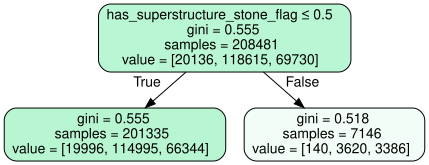

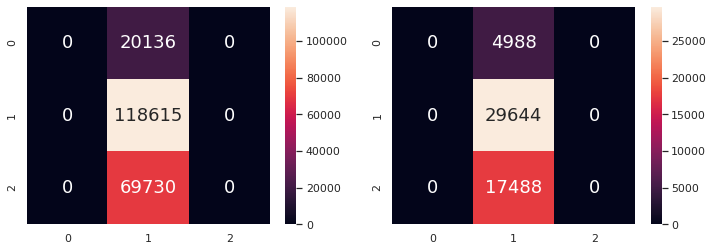

In [0]:
# Import essential models and functions from sklearn
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.tree import export_graphviz
import graphviz

# Extract Response and Predictors
y9 = pd.DataFrame(df3['damage_grade'])
X9 = pd.DataFrame(numtrain['has_superstructure_stone_flag'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X9_train, X9_test, y9_train, y9_test = train_test_split(X9, y9, test_size = no)

# Decision Tree using Train Data
dectree = DecisionTreeClassifier(max_depth = 4)  # create the decision tree object
dectree.fit(X9_train, y9_train)                    # train the decision tree model

# Predict Response corresponding to Predictors
y9_train_pred = dectree.predict(X9_train)
y9_test_pred = dectree.predict(X9_test)

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", dectree.score(X9_train, y9_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", dectree.score(X9_test, y9_test))
print()

#Classification Metrics
from sklearn.metrics import classification_report

print(classification_report(y9_test, y9_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y9_train, y9_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y9_test, y9_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

# Plot the Decision Tree
treedot = export_graphviz(dectree,                                      # the model
                          feature_names = X9_train.columns,              # the features 
                          out_file = None,                              # output file
                          filled = True,                                # node colors
                          rounded = True,                               # make pretty
                          special_characters = True)                    # postscript

graphviz.Source(treedot)


Train Size: 208481
Testing Size: 52120
Total Size: 260601
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.5672219530796572

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.5698580199539525

Accuracy: 0.5698580199539525


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



              precision    recall  f1-score   support

           1       0.00      0.00      0.00     20054
           2       0.57      0.97      0.72    118513
           3       0.47      0.05      0.09     69914

    accuracy                           0.57    208481
   macro avg       0.35      0.34      0.27    208481
weighted avg       0.48      0.57      0.44    208481

              precision    recall  f1-score   support

           1       0.00      0.00      0.00      5070
           2       0.57      0.97      0.72     29746
           3       0.48      0.05      0.09     17304

    accuracy                           0.57     52120
   macro avg       0.35      0.34      0.27     52120
weighted avg       0.49      0.57      0.44     52120



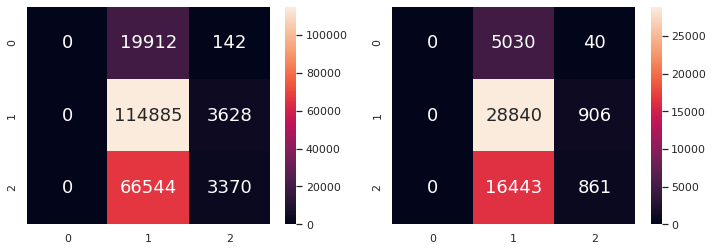

In [0]:
#Import scikit-learn metrics module for accuracy calculation
from sklearn.naive_bayes import GaussianNB
from sklearn import metrics
from sklearn.metrics import classification_report


# Extract Response and Predictors
ylasty = pd.DataFrame(df3['damage_grade'])
Xlasty = pd.DataFrame(numericdata['has_superstructure_stone_flag'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X_train, X_test, y_train, y_test = train_test_split(Xlasty, ylasty, test_size = no)


#Create a Gaussian Classifier and #rain the model using the training sets
gnb = GaussianNB()
gnb.fit(X_train, y_train.values.ravel())



#Predict the response for train & test dataset
y_train_pred = gnb.predict(X_train)
y_test_pred = gnb.predict(X_test)
 

#Import scikit-learn metrics module for accuracy calculation
from sklearn import metrics

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", gnb.score(X_train, y_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", gnb.score(X_test, y_test))
print()


# Model Accuracy, how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, y_test_pred))
print(classification_report(y_train, y_train_pred))
print(classification_report(y_test, y_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y_train, y_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y_test, y_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

In [0]:
#has_superstructure_cement_mortar_stone

Train Size: 208481
Testing Size: 52120
Total Size: 260601
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.5683539507197298

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.5711435149654643

              precision    recall  f1-score   support

           1       0.00      0.00      0.00      5053
           2       0.57      1.00      0.73     29768
           3       0.00      0.00      0.00     17299

    accuracy                           0.57     52120
   macro avg       0.19      0.33      0.24     52120
weighted avg       0.33      0.57      0.42     52120



/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


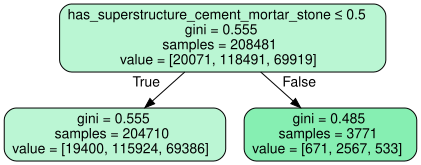

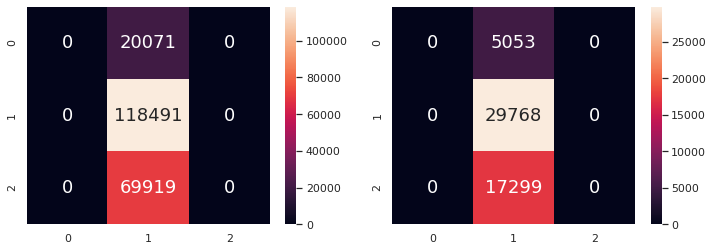

In [0]:
# Import essential models and functions from sklearn
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.tree import export_graphviz
import graphviz

# Extract Response and Predictors
y91 = pd.DataFrame(numtrain['damage_grade'])
X91 = pd.DataFrame(numtrain['has_superstructure_cement_mortar_stone'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X91_train, X91_test, y91_train, y91_test = train_test_split(X91, y91, test_size = no)

# Decision Tree using Train Data
dectree = DecisionTreeClassifier(max_depth = 4)  # create the decision tree object
dectree.fit(X91_train, y91_train)                    # train the decision tree model

# Predict Response corresponding to Predictors
y91_train_pred = dectree.predict(X91_train)
y91_test_pred = dectree.predict(X91_test)

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", dectree.score(X91_train, y91_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", dectree.score(X91_test, y91_test))
print()

#Classification Metrics
from sklearn.metrics import classification_report

print(classification_report(y91_test, y91_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y91_train, y91_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y91_test, y91_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

# Plot the Decision Tree
treedot = export_graphviz(dectree,                                      # the model
                          feature_names = X91_train.columns,              # the features 
                          out_file = None,                              # output file
                          filled = True,                                # node colors
                          rounded = True,                               # make pretty
                          special_characters = True)                    # postscript

graphviz.Source(treedot)


Train Size: 208481
Testing Size: 52120
Total Size: 260601
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.3350808946618637

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.33603223330775134

Accuracy: 0.33603223330775134


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



              precision    recall  f1-score   support

           1       0.17      0.03      0.06     20253
           2       0.00      0.00      0.00    118503
           3       0.34      0.99      0.50     69725

    accuracy                           0.34    208481
   macro avg       0.17      0.34      0.19    208481
weighted avg       0.13      0.34      0.17    208481

              precision    recall  f1-score   support

           1       0.17      0.03      0.06      4871
           2       0.00      0.00      0.00     29756
           3       0.34      0.99      0.51     17493

    accuracy                           0.34     52120
   macro avg       0.17      0.34      0.19     52120
weighted avg       0.13      0.34      0.17     52120



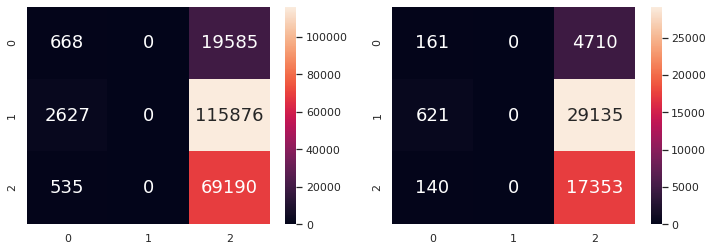

In [0]:
#Import scikit-learn metrics module for accuracy calculation
from sklearn.naive_bayes import GaussianNB
from sklearn import metrics
from sklearn.metrics import classification_report


# Extract Response and Predictors
ylasty = pd.DataFrame(df3['damage_grade'])
Xlasty = pd.DataFrame(numericdata['has_superstructure_cement_mortar_stone'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X_train, X_test, y_train, y_test = train_test_split(Xlasty, ylasty, test_size = no)


#Create a Gaussian Classifier and #rain the model using the training sets
gnb = GaussianNB()
gnb.fit(X_train, y_train.values.ravel())



#Predict the response for train & test dataset
y_train_pred = gnb.predict(X_train)
y_test_pred = gnb.predict(X_test)
 

#Import scikit-learn metrics module for accuracy calculation
from sklearn import metrics

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", gnb.score(X_train, y_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", gnb.score(X_test, y_test))
print()


# Model Accuracy, how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, y_test_pred))
print(classification_report(y_train, y_train_pred))
print(classification_report(y_test, y_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y_train, y_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y_test, y_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

In [0]:
#has_superstructure_mud_mortar_brick

Train Size: 208481
Testing Size: 52120
Total Size: 260601
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.569188559149275

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.5678050652340753

              precision    recall  f1-score   support

           1       0.00      0.00      0.00      5011
           2       0.57      1.00      0.72     29594
           3       0.00      0.00      0.00     17515

    accuracy                           0.57     52120
   macro avg       0.19      0.33      0.24     52120
weighted avg       0.32      0.57      0.41     52120



/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


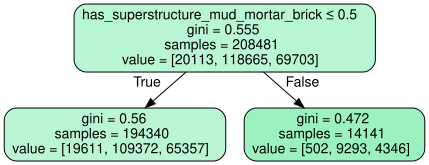

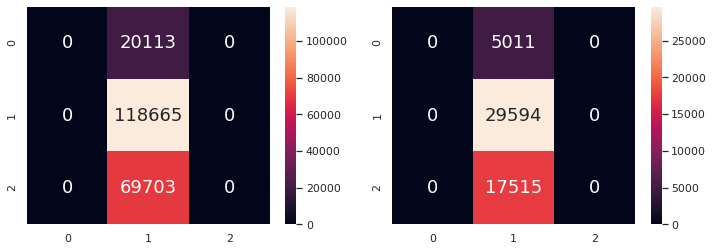

In [0]:
# Import essential models and functions from sklearn
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.tree import export_graphviz
import graphviz

# Extract Response and Predictors
y92 = pd.DataFrame(numtrain['damage_grade'])
X92 = pd.DataFrame(numtrain['has_superstructure_mud_mortar_brick'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X92_train, X92_test, y92_train, y92_test = train_test_split(X92, y92, test_size = no)

# Decision Tree using Train Data
dectree = DecisionTreeClassifier(max_depth = 4)  # create the decision tree object
dectree.fit(X92_train, y92_train)                    # train the decision tree model

# Predict Response corresponding to Predictors
y92_train_pred = dectree.predict(X92_train)
y92_test_pred = dectree.predict(X92_test)

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", dectree.score(X92_train, y92_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", dectree.score(X92_test, y92_test))
print()

#Classification Metrics
from sklearn.metrics import classification_report

print(classification_report(y92_test, y92_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y92_train, y92_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y92_test, y92_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

# Plot the Decision Tree
treedot = export_graphviz(dectree,                                      # the model
                          feature_names = X92_train.columns,              # the features 
                          out_file = None,                              # output file
                          filled = True,                                # node colors
                          rounded = True,                               # make pretty
                          special_characters = True)                    # postscript

graphviz.Source(treedot)


Train Size: 208481
Testing Size: 52120
Total Size: 260601
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.5690782373453696

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.5682463545663853

Accuracy: 0.5682463545663853


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



              precision    recall  f1-score   support

           1       0.00      0.00      0.00     20060
           2       0.57      1.00      0.73    118642
           3       0.00      0.00      0.00     69779

    accuracy                           0.57    208481
   macro avg       0.19      0.33      0.24    208481
weighted avg       0.32      0.57      0.41    208481

              precision    recall  f1-score   support

           1       0.00      0.00      0.00      5064
           2       0.57      1.00      0.72     29617
           3       0.00      0.00      0.00     17439

    accuracy                           0.57     52120
   macro avg       0.19      0.33      0.24     52120
weighted avg       0.32      0.57      0.41     52120



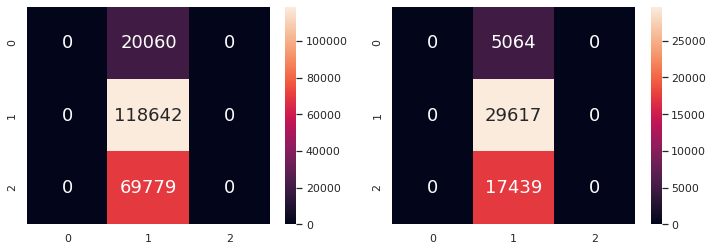

In [0]:
#Import scikit-learn metrics module for accuracy calculation
from sklearn.naive_bayes import GaussianNB
from sklearn import metrics
from sklearn.metrics import classification_report


# Extract Response and Predictors
ylasty = pd.DataFrame(df3['damage_grade'])
Xlasty = pd.DataFrame(numericdata['has_superstructure_mud_mortar_brick'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X_train, X_test, y_train, y_test = train_test_split(Xlasty, ylasty, test_size = no)


#Create a Gaussian Classifier and #rain the model using the training sets
gnb = GaussianNB()
gnb.fit(X_train, y_train.values.ravel())



#Predict the response for train & test dataset
y_train_pred = gnb.predict(X_train)
y_test_pred = gnb.predict(X_test)
 

#Import scikit-learn metrics module for accuracy calculation
from sklearn import metrics

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", gnb.score(X_train, y_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", gnb.score(X_test, y_test))
print()


# Model Accuracy, how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, y_test_pred))
print(classification_report(y_train, y_train_pred))
print(classification_report(y_test, y_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y_train, y_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y_test, y_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

In [0]:
#has_superstructure_cement_mortar_brick

Train Size: 208481
Testing Size: 52120
Total Size: 260601
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.5684354929226164

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.570817344589409

              precision    recall  f1-score   support

           1       0.00      0.00      0.00      4947
           2       0.57      1.00      0.73     29751
           3       0.00      0.00      0.00     17422

    accuracy                           0.57     52120
   macro avg       0.19      0.33      0.24     52120
weighted avg       0.33      0.57      0.41     52120



/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


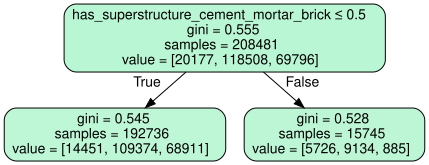

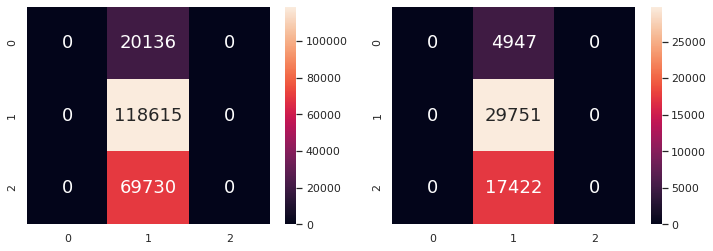

In [0]:
# Import essential models and functions from sklearn
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.tree import export_graphviz
import graphviz

# Extract Response and Predictors
y93 = pd.DataFrame(numtrain['damage_grade'])
X93 = pd.DataFrame(numtrain['has_superstructure_cement_mortar_brick'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X93_train, X93_test, y93_train, y93_test = train_test_split(X93, y93, test_size = no)

# Decision Tree using Train Data
dectree = DecisionTreeClassifier(max_depth = 4)  # create the decision tree object
dectree.fit(X93_train, y93_train)                    # train the decision tree model

# Predict Response corresponding to Predictors
y93_train_pred = dectree.predict(X93_train)
y93_test_pred = dectree.predict(X93_test)

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", dectree.score(X93_train, y93_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", dectree.score(X93_test, y93_test))
print()

#Classification Metrics
from sklearn.metrics import classification_report

print(classification_report(y93_test, y93_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y9_train, y93_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y93_test, y93_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

# Plot the Decision Tree
treedot = export_graphviz(dectree,                                      # the model
                          feature_names = X93_train.columns,              # the features 
                          out_file = None,                              # output file
                          filled = True,                                # node colors
                          rounded = True,                               # make pretty
                          special_characters = True)                    # postscript

graphviz.Source(treedot)


Train Size: 208481
Testing Size: 52120
Total Size: 260601
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.35829164288352416

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.35566001534919417

Accuracy: 0.35566001534919417


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



              precision    recall  f1-score   support

           1       0.36      0.28      0.32     19996
           2       0.00      0.00      0.00    118640
           3       0.36      0.99      0.53     69845

    accuracy                           0.36    208481
   macro avg       0.24      0.42      0.28    208481
weighted avg       0.15      0.36      0.21    208481

              precision    recall  f1-score   support

           1       0.36      0.28      0.31      5128
           2       0.00      0.00      0.00     29619
           3       0.36      0.99      0.52     17373

    accuracy                           0.36     52120
   macro avg       0.24      0.42      0.28     52120
weighted avg       0.15      0.36      0.20     52120



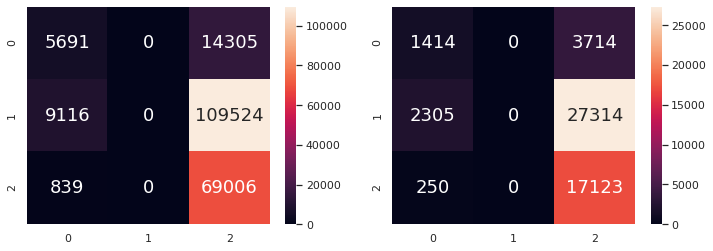

In [0]:
#Import scikit-learn metrics module for accuracy calculation
from sklearn.naive_bayes import GaussianNB
from sklearn import metrics
from sklearn.metrics import classification_report


# Extract Response and Predictors
ylasty = pd.DataFrame(df3['damage_grade'])
Xlasty = pd.DataFrame(numericdata['has_superstructure_cement_mortar_brick'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X_train, X_test, y_train, y_test = train_test_split(Xlasty, ylasty, test_size = no)


#Create a Gaussian Classifier and #rain the model using the training sets
gnb = GaussianNB()
gnb.fit(X_train, y_train.values.ravel())



#Predict the response for train & test dataset
y_train_pred = gnb.predict(X_train)
y_test_pred = gnb.predict(X_test)
 

#Import scikit-learn metrics module for accuracy calculation
from sklearn import metrics

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", gnb.score(X_train, y_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", gnb.score(X_test, y_test))
print()


# Model Accuracy, how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, y_test_pred))
print(classification_report(y_train, y_train_pred))
print(classification_report(y_test, y_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y_train, y_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y_test, y_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

In [0]:
#count_families

Train Size: 208481
Testing Size: 52120
Total Size: 260601
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.5696778123665945

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.5658288564850346

              precision    recall  f1-score   support

           1       0.00      0.00      0.00      5134
           2       0.57      1.00      0.72     29493
           3       0.00      0.00      0.00     17493

    accuracy                           0.57     52120
   macro avg       0.19      0.33      0.24     52120
weighted avg       0.32      0.57      0.41     52120



/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


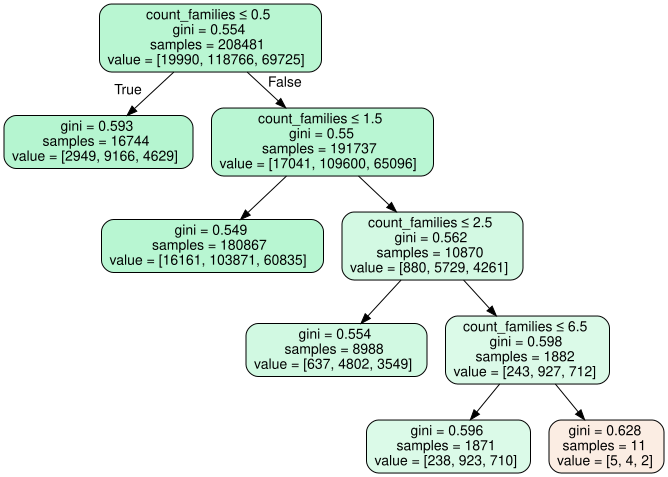

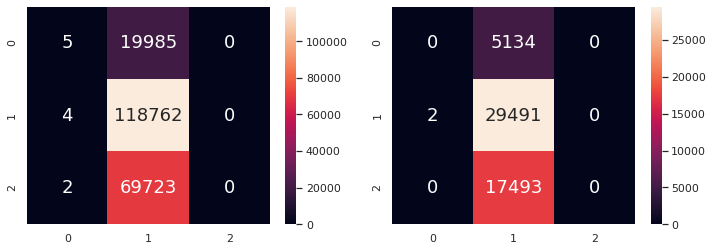

In [0]:
# Import essential models and functions from sklearn
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.tree import export_graphviz
import graphviz

# Extract Response and Predictors
y94 = pd.DataFrame(numtrain['damage_grade'])
X94 = pd.DataFrame(numtrain['count_families'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X94_train, X94_test, y94_train, y94_test = train_test_split(X94, y94, test_size = no)

# Decision Tree using Train Data
dectree = DecisionTreeClassifier(max_depth = 4)  # create the decision tree object
dectree.fit(X94_train, y94_train)                    # train the decision tree model

# Predict Response corresponding to Predictors
y94_train_pred = dectree.predict(X94_train)
y94_test_pred = dectree.predict(X94_test)

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", dectree.score(X94_train, y94_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", dectree.score(X94_test, y94_test))
print()

#Classification Metrics
from sklearn.metrics import classification_report

print(classification_report(y94_test, y94_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y94_train, y94_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y94_test, y94_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

# Plot the Decision Tree
treedot = export_graphviz(dectree,                                      # the model
                          feature_names = X94_train.columns,              # the features 
                          out_file = None,                              # output file
                          filled = True,                                # node colors
                          rounded = True,                               # make pretty
                          special_characters = True)                    # postscript

graphviz.Source(treedot)


Train Size: 208481
Testing Size: 52120
Total Size: 260601
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.5648476359956063

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.5686108979278588

Accuracy: 0.5686108979278588


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



              precision    recall  f1-score   support

           1       0.13      0.01      0.02     20075
           2       0.57      0.99      0.72    118431
           3       0.00      0.00      0.00     69975

    accuracy                           0.56    208481
   macro avg       0.23      0.33      0.25    208481
weighted avg       0.34      0.56      0.41    208481

              precision    recall  f1-score   support

           1       0.13      0.01      0.02      5049
           2       0.57      0.99      0.73     29828
           3       0.00      0.00      0.00     17243

    accuracy                           0.57     52120
   macro avg       0.23      0.33      0.25     52120
weighted avg       0.34      0.57      0.42     52120



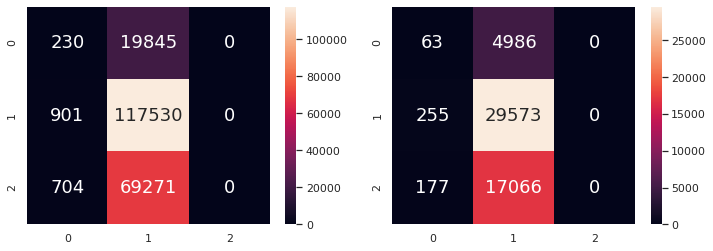

In [0]:
#Import scikit-learn metrics module for accuracy calculation
from sklearn.naive_bayes import GaussianNB
from sklearn import metrics
from sklearn.metrics import classification_report


# Extract Response and Predictors
ylasty = pd.DataFrame(df3['damage_grade'])
Xlasty = pd.DataFrame(numericdata['count_families'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X_train, X_test, y_train, y_test = train_test_split(Xlasty, ylasty, test_size = no)


#Create a Gaussian Classifier and #rain the model using the training sets
gnb = GaussianNB()
gnb.fit(X_train, y_train.values.ravel())



#Predict the response for train & test dataset
y_train_pred = gnb.predict(X_train)
y_test_pred = gnb.predict(X_test)
 

#Import scikit-learn metrics module for accuracy calculation
from sklearn import metrics

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", gnb.score(X_train, y_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", gnb.score(X_test, y_test))
print()


# Model Accuracy, how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, y_test_pred))
print(classification_report(y_train, y_train_pred))
print(classification_report(y_test, y_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y_train, y_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y_test, y_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

In [0]:
#has_superstructure_timber

Train Size: 208481
Testing Size: 52120
Total Size: 260601
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.5690830339455394

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.5682271680736761

              precision    recall  f1-score   support

           1       0.00      0.00      0.00      5062
           2       0.57      1.00      0.72     29616
           3       0.00      0.00      0.00     17442

    accuracy                           0.57     52120
   macro avg       0.19      0.33      0.24     52120
weighted avg       0.32      0.57      0.41     52120



/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


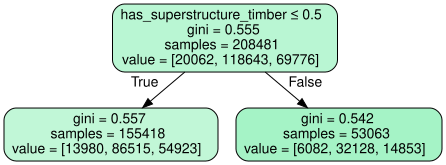

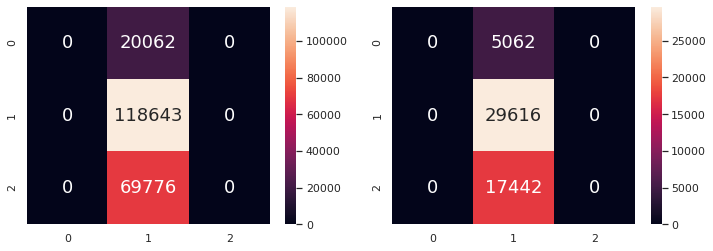

In [0]:
# Import essential models and functions from sklearn
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.tree import export_graphviz
import graphviz

# Extract Response and Predictors
y95 = pd.DataFrame(numtrain['damage_grade'])
X95 = pd.DataFrame(numtrain['has_superstructure_timber'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X95_train, X95_test, y95_train, y95_test = train_test_split(X95, y95, test_size = no)

# Decision Tree using Train Data
dectree = DecisionTreeClassifier(max_depth = 4)  # create the decision tree object
dectree.fit(X95_train, y95_train)                    # train the decision tree model

# Predict Response corresponding to Predictors
y95_train_pred = dectree.predict(X95_train)
y95_test_pred = dectree.predict(X95_test)

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", dectree.score(X95_train, y95_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", dectree.score(X95_test, y95_test))
print()

#Classification Metrics
from sklearn.metrics import classification_report

print(classification_report(y95_test, y95_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y95_train, y95_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y95_test, y95_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

# Plot the Decision Tree
treedot = export_graphviz(dectree,                                      # the model
                          feature_names = X95_train.columns,              # the features 
                          out_file = None,                              # output file
                          filled = True,                                # node colors
                          rounded = True,                               # make pretty
                          special_characters = True)                    # postscript

graphviz.Source(treedot)


Train Size: 208481
Testing Size: 52120
Total Size: 260601
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.5689918985423132

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.5685917114351496

Accuracy: 0.5685917114351496


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



              precision    recall  f1-score   support

           1       0.00      0.00      0.00     20031
           2       0.57      1.00      0.73    118624
           3       0.00      0.00      0.00     69826

    accuracy                           0.57    208481
   macro avg       0.19      0.33      0.24    208481
weighted avg       0.32      0.57      0.41    208481

              precision    recall  f1-score   support

           1       0.00      0.00      0.00      5093
           2       0.57      1.00      0.72     29635
           3       0.00      0.00      0.00     17392

    accuracy                           0.57     52120
   macro avg       0.19      0.33      0.24     52120
weighted avg       0.32      0.57      0.41     52120



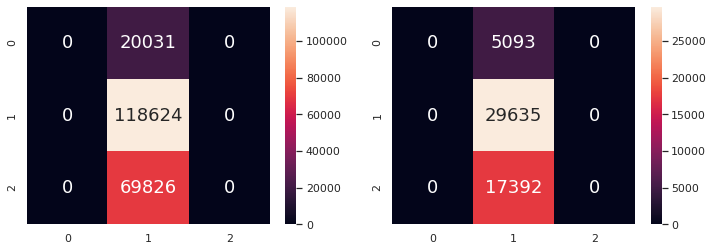

In [0]:
#Import scikit-learn metrics module for accuracy calculation
from sklearn.naive_bayes import GaussianNB
from sklearn import metrics
from sklearn.metrics import classification_report


# Extract Response and Predictors
ylasty = pd.DataFrame(df3['damage_grade'])
Xlasty = pd.DataFrame(numericdata['has_superstructure_timber'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X_train, X_test, y_train, y_test = train_test_split(Xlasty, ylasty, test_size = no)


#Create a Gaussian Classifier and #rain the model using the training sets
gnb = GaussianNB()
gnb.fit(X_train, y_train.values.ravel())



#Predict the response for train & test dataset
y_train_pred = gnb.predict(X_train)
y_test_pred = gnb.predict(X_test)
 

#Import scikit-learn metrics module for accuracy calculation
from sklearn import metrics

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", gnb.score(X_train, y_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", gnb.score(X_test, y_test))
print()


# Model Accuracy, how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, y_test_pred))
print(classification_report(y_train, y_train_pred))
print(classification_report(y_test, y_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y_train, y_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y_test, y_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

In [0]:

#has_superstructure_bamboo

Train Size: 208481
Testing Size: 52120
Total Size: 260601
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.5690302713436716

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.5684382194934766

              precision    recall  f1-score   support

           1       0.00      0.00      0.00      5043
           2       0.57      1.00      0.72     29627
           3       0.00      0.00      0.00     17450

    accuracy                           0.57     52120
   macro avg       0.19      0.33      0.24     52120
weighted avg       0.32      0.57      0.41     52120



/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


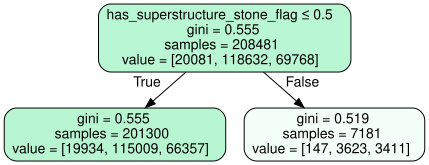

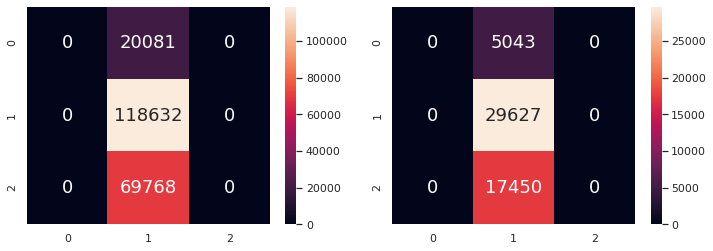

In [0]:
# Import essential models and functions from sklearn
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.tree import export_graphviz
import graphviz

# Extract Response and Predictors
y96 = pd.DataFrame(numtrain['damage_grade'])
X96 = pd.DataFrame(numtrain['has_superstructure_bamboo'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X96_train, X96_test, y96_train, y96_test = train_test_split(X9, y9, test_size = no)

# Decision Tree using Train Data
dectree = DecisionTreeClassifier(max_depth = 4)  # create the decision tree object
dectree.fit(X96_train, y96_train)                    # train the decision tree model

# Predict Response corresponding to Predictors
y96_train_pred = dectree.predict(X96_train)
y96_test_pred = dectree.predict(X96_test)

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", dectree.score(X96_train, y96_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", dectree.score(X96_test, y96_test))
print()

#Classification Metrics
from sklearn.metrics import classification_report

print(classification_report(y96_test, y96_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y96_train, y96_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y96_test, y96_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

# Plot the Decision Tree
treedot = export_graphviz(dectree,                                      # the model
                          feature_names = X96_train.columns,              # the features 
                          out_file = None,                              # output file
                          filled = True,                                # node colors
                          rounded = True,                               # make pretty
                          special_characters = True)                    # postscript

graphviz.Source(treedot)


Train Size: 208481
Testing Size: 52120
Total Size: 260601
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.5682292391153151

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.5716423637759017

Accuracy: 0.5716423637759017


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



              precision    recall  f1-score   support

           1       0.00      0.00      0.00     20161
           2       0.57      1.00      0.72    118465
           3       0.00      0.00      0.00     69855

    accuracy                           0.57    208481
   macro avg       0.19      0.33      0.24    208481
weighted avg       0.32      0.57      0.41    208481

              precision    recall  f1-score   support

           1       0.00      0.00      0.00      4963
           2       0.57      1.00      0.73     29794
           3       0.00      0.00      0.00     17363

    accuracy                           0.57     52120
   macro avg       0.19      0.33      0.24     52120
weighted avg       0.33      0.57      0.42     52120



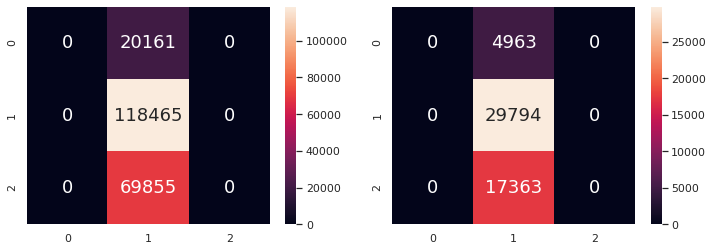

In [0]:
#Import scikit-learn metrics module for accuracy calculation
from sklearn.naive_bayes import GaussianNB
from sklearn import metrics
from sklearn.metrics import classification_report


# Extract Response and Predictors
ylasty = pd.DataFrame(df3['damage_grade'])
Xlasty = pd.DataFrame(numericdata['has_superstructure_bamboo'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X_train, X_test, y_train, y_test = train_test_split(Xlasty, ylasty, test_size = no)


#Create a Gaussian Classifier and #rain the model using the training sets
gnb = GaussianNB()
gnb.fit(X_train, y_train.values.ravel())



#Predict the response for train & test dataset
y_train_pred = gnb.predict(X_train)
y_test_pred = gnb.predict(X_test)
 

#Import scikit-learn metrics module for accuracy calculation
from sklearn import metrics

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", gnb.score(X_train, y_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", gnb.score(X_test, y_test))
print()


# Model Accuracy, how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, y_test_pred))
print(classification_report(y_train, y_train_pred))
print(classification_report(y_test, y_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y_train, y_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y_test, y_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

In [0]:
#has_superstructure_rc_non_engineered

Train Size: 208481
Testing Size: 52120
Total Size: 260601
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.5681045275109002

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.5721412125863392

              precision    recall  f1-score   support

           1       0.00      0.00      0.00      4924
           2       0.57      1.00      0.73     29820
           3       0.00      0.00      0.00     17376

    accuracy                           0.57     52120
   macro avg       0.19      0.33      0.24     52120
weighted avg       0.33      0.57      0.42     52120



/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


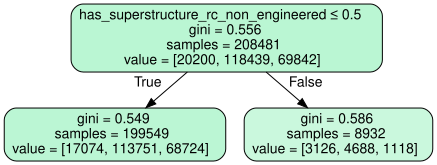

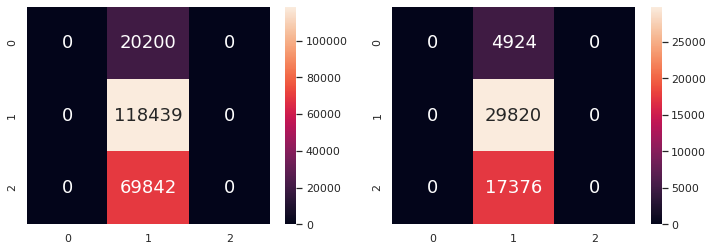

In [0]:
# Import essential models and functions from sklearn
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.tree import export_graphviz
import graphviz

# Extract Response and Predictors
y97 = pd.DataFrame(numtrain['damage_grade'])
X97 = pd.DataFrame(numtrain['has_superstructure_rc_non_engineered'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X97_train, X97_test, y97_train, y97_test = train_test_split(X97, y97, test_size = no)

# Decision Tree using Train Data
dectree = DecisionTreeClassifier(max_depth = 4)  # create the decision tree object
dectree.fit(X97_train, y97_train)                    # train the decision tree model

# Predict Response corresponding to Predictors
y97_train_pred = dectree.predict(X97_train)
y97_test_pred = dectree.predict(X97_test)

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", dectree.score(X97_train, y97_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", dectree.score(X97_test, y97_test))
print()

#Classification Metrics
from sklearn.metrics import classification_report

print(classification_report(y97_test, y97_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y97_train, y97_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y97_test, y97_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

# Plot the Decision Tree
treedot = export_graphviz(dectree,                                      # the model
                          feature_names = X97_train.columns,              # the features 
                          out_file = None,                              # output file
                          filled = True,                                # node colors
                          rounded = True,                               # make pretty
                          special_characters = True)                    # postscript

graphviz.Source(treedot)


Train Size: 208481
Testing Size: 52120
Total Size: 260601
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.5623294209064615

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.5573484267075979

Accuracy: 0.5573484267075979


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



              precision    recall  f1-score   support

           1       0.35      0.15      0.21     20049
           2       0.57      0.96      0.72    118789
           3       0.00      0.00      0.00     69643

    accuracy                           0.56    208481
   macro avg       0.31      0.37      0.31    208481
weighted avg       0.36      0.56      0.43    208481

              precision    recall  f1-score   support

           1       0.34      0.15      0.21      5075
           2       0.57      0.96      0.71     29470
           3       0.00      0.00      0.00     17575

    accuracy                           0.56     52120
   macro avg       0.30      0.37      0.31     52120
weighted avg       0.35      0.56      0.42     52120



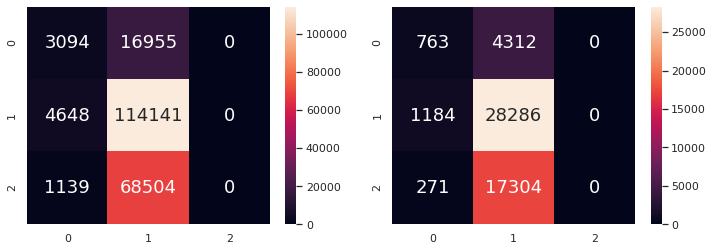

In [0]:
#Import scikit-learn metrics module for accuracy calculation
from sklearn.naive_bayes import GaussianNB
from sklearn import metrics
from sklearn.metrics import classification_report


# Extract Response and Predictors
ylasty = pd.DataFrame(df3['damage_grade'])
Xlasty = pd.DataFrame(numericdata['has_superstructure_rc_non_engineered'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X_train, X_test, y_train, y_test = train_test_split(Xlasty, ylasty, test_size = no)


#Create a Gaussian Classifier and #rain the model using the training sets
gnb = GaussianNB()
gnb.fit(X_train, y_train.values.ravel())



#Predict the response for train & test dataset
y_train_pred = gnb.predict(X_train)
y_test_pred = gnb.predict(X_test)
 

#Import scikit-learn metrics module for accuracy calculation
from sklearn import metrics

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", gnb.score(X_train, y_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", gnb.score(X_test, y_test))
print()


# Model Accuracy, how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, y_test_pred))
print(classification_report(y_train, y_train_pred))
print(classification_report(y_test, y_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y_train, y_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y_test, y_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

In [0]:
#has_superstructure_rc_engineered

Train Size: 208481
Testing Size: 52120
Total Size: 260601
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.5734719231009061

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.5747313891020721

              precision    recall  f1-score   support

           1       0.65      0.11      0.18      4925
           2       0.57      0.99      0.73     29697
           3       0.00      0.00      0.00     17498

    accuracy                           0.57     52120
   macro avg       0.41      0.37      0.30     52120
weighted avg       0.39      0.57      0.43     52120



/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


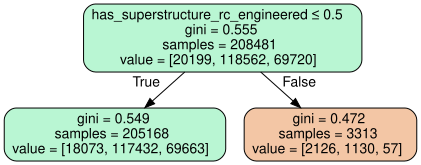

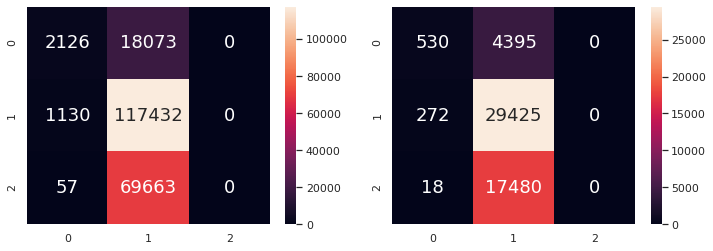

In [0]:
# Import essential models and functions from sklearn
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.tree import export_graphviz
import graphviz

# Extract Response and Predictors
y98 = pd.DataFrame(numtrain['damage_grade'])
X98 = pd.DataFrame(numtrain['has_superstructure_rc_engineered'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X98_train, X98_test, y98_train, y98_test = train_test_split(X98, y98, test_size = no)

# Decision Tree using Train Data
dectree = DecisionTreeClassifier(max_depth = 4)  # create the decision tree object
dectree.fit(X98_train, y98_train)                    # train the decision tree model

# Predict Response corresponding to Predictors
y98_train_pred = dectree.predict(X98_train)
y98_test_pred = dectree.predict(X98_test)

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", dectree.score(X98_train, y98_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", dectree.score(X98_test, y98_test))
print()

#Classification Metrics
from sklearn.metrics import classification_report

print(classification_report(y98_test, y98_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y98_train, y98_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y98_test, y98_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

# Plot the Decision Tree
treedot = export_graphviz(dectree,                                      # the model
                          feature_names = X98_train.columns,              # the features 
                          out_file = None,                              # output file
                          filled = True,                                # node colors
                          rounded = True,                               # make pretty
                          special_characters = True)                    # postscript

graphviz.Source(treedot)


Train Size: 208481
Testing Size: 52120
Total Size: 260601
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.3442232145855018

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.34602839600920954

Accuracy: 0.34602839600920954


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



              precision    recall  f1-score   support

           1       0.64      0.10      0.18     20146
           2       0.00      0.00      0.00    118619
           3       0.34      1.00      0.51     69716

    accuracy                           0.34    208481
   macro avg       0.33      0.37      0.23    208481
weighted avg       0.18      0.34      0.19    208481

              precision    recall  f1-score   support

           1       0.64      0.11      0.19      4978
           2       0.00      0.00      0.00     29640
           3       0.34      1.00      0.51     17502

    accuracy                           0.35     52120
   macro avg       0.33      0.37      0.23     52120
weighted avg       0.18      0.35      0.19     52120



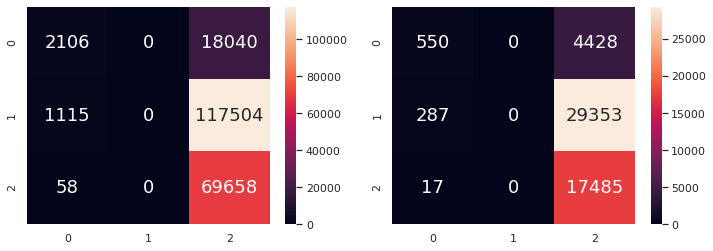

In [0]:
#Import scikit-learn metrics module for accuracy calculation
from sklearn.naive_bayes import GaussianNB
from sklearn import metrics
from sklearn.metrics import classification_report


# Extract Response and Predictors
ylasty = pd.DataFrame(df3['damage_grade'])
Xlasty = pd.DataFrame(numericdata['has_superstructure_rc_engineered'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X_train, X_test, y_train, y_test = train_test_split(Xlasty, ylasty, test_size = no)


#Create a Gaussian Classifier and #rain the model using the training sets
gnb = GaussianNB()
gnb.fit(X_train, y_train.values.ravel())



#Predict the response for train & test dataset
y_train_pred = gnb.predict(X_train)
y_test_pred = gnb.predict(X_test)
 

#Import scikit-learn metrics module for accuracy calculation
from sklearn import metrics

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", gnb.score(X_train, y_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", gnb.score(X_test, y_test))
print()


# Model Accuracy, how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, y_test_pred))
print(classification_report(y_train, y_train_pred))
print(classification_report(y_test, y_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y_train, y_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y_test, y_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

In [0]:
#has_superstructure_other

Train Size: 208481
Testing Size: 52120
Total Size: 260601
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.5681812731136171

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.571834228702993

              precision    recall  f1-score   support

           1       0.00      0.00      0.00      5043
           2       0.57      1.00      0.73     29804
           3       0.00      0.00      0.00     17273

    accuracy                           0.57     52120
   macro avg       0.19      0.33      0.24     52120
weighted avg       0.33      0.57      0.42     52120



/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


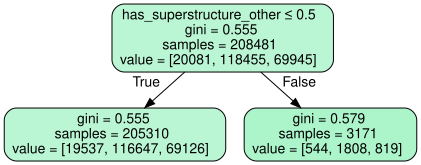

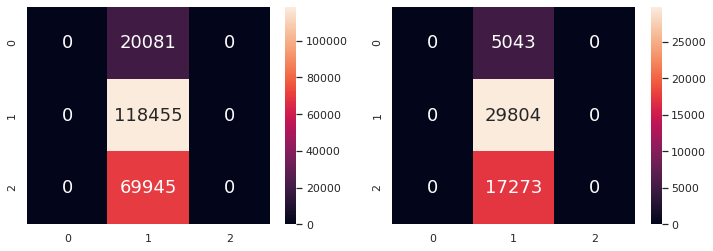

In [0]:
# Import essential models and functions from sklearn
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.tree import export_graphviz
import graphviz

# Extract Response and Predictors
y99 = pd.DataFrame(numtrain['damage_grade'])
X99 = pd.DataFrame(numtrain['has_superstructure_other'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X99_train, X99_test, y99_train, y99_test = train_test_split(X99, y99, test_size = no)

# Decision Tree using Train Data
dectree = DecisionTreeClassifier(max_depth = 4)  # create the decision tree object
dectree.fit(X99_train, y99_train)                    # train the decision tree model

# Predict Response corresponding to Predictors
y99_train_pred = dectree.predict(X9_train)
y99_test_pred = dectree.predict(X99_test)

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", dectree.score(X99_train, y99_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", dectree.score(X99_test, y99_test))
print()

#Classification Metrics
from sklearn.metrics import classification_report

print(classification_report(y99_test, y99_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y99_train, y99_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y99_test, y99_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

# Plot the Decision Tree
treedot = export_graphviz(dectree,                                      # the model
                          feature_names = X99_train.columns,              # the features 
                          out_file = None,                              # output file
                          filled = True,                                # node colors
                          rounded = True,                               # make pretty
                          special_characters = True)                    # postscript

graphviz.Source(treedot)


Train Size: 208481
Testing Size: 52120
Total Size: 260601
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.5627898945227623

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.562854950115119

Accuracy: 0.562854950115119


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



              precision    recall  f1-score   support

           1       0.17      0.03      0.04     20133
           2       0.57      0.98      0.72    118595
           3       0.00      0.00      0.00     69753

    accuracy                           0.56    208481
   macro avg       0.25      0.34      0.26    208481
weighted avg       0.34      0.56      0.41    208481

              precision    recall  f1-score   support

           1       0.17      0.03      0.05      4991
           2       0.57      0.98      0.72     29664
           3       0.00      0.00      0.00     17465

    accuracy                           0.56     52120
   macro avg       0.25      0.34      0.26     52120
weighted avg       0.34      0.56      0.42     52120



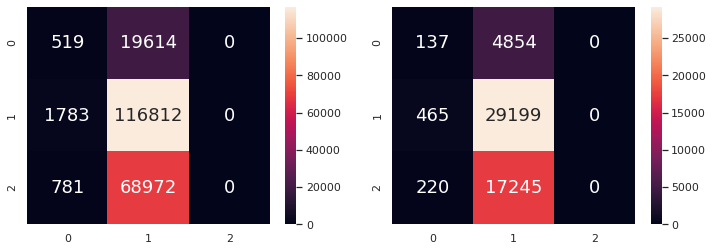

In [0]:
#Import scikit-learn metrics module for accuracy calculation
from sklearn.naive_bayes import GaussianNB
from sklearn import metrics
from sklearn.metrics import classification_report


# Extract Response and Predictors
ylasty = pd.DataFrame(df3['damage_grade'])
Xlasty = pd.DataFrame(numericdata['has_superstructure_other'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X_train, X_test, y_train, y_test = train_test_split(Xlasty, ylasty, test_size = no)


#Create a Gaussian Classifier and #rain the model using the training sets
gnb = GaussianNB()
gnb.fit(X_train, y_train.values.ravel())



#Predict the response for train & test dataset
y_train_pred = gnb.predict(X_train)
y_test_pred = gnb.predict(X_test)
 

#Import scikit-learn metrics module for accuracy calculation
from sklearn import metrics

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", gnb.score(X_train, y_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", gnb.score(X_test, y_test))
print()


# Model Accuracy, how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, y_test_pred))
print(classification_report(y_train, y_train_pred))
print(classification_report(y_test, y_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y_train, y_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y_test, y_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

In [0]:
#has_secondary_use

Train Size: 208481
Testing Size: 52120
Total Size: 260601
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.5691357965474072

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.5680161166538756

              precision    recall  f1-score   support

           1       0.00      0.00      0.00      5101
           2       0.57      1.00      0.72     29605
           3       0.00      0.00      0.00     17414

    accuracy                           0.57     52120
   macro avg       0.19      0.33      0.24     52120
weighted avg       0.32      0.57      0.41     52120



/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


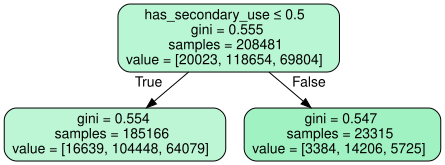

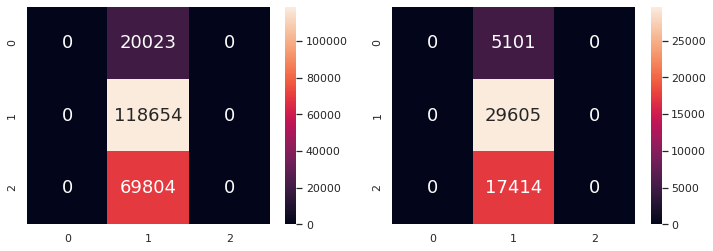

In [0]:
# Import essential models and functions from sklearn
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.tree import export_graphviz
import graphviz

# Extract Response and Predictors
y9a = pd.DataFrame(numtrain['damage_grade'])
X9a = pd.DataFrame(numtrain['has_secondary_use'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X9a_train, X9a_test, y9a_train, y9a_test = train_test_split(X9a, y9a, test_size = no)

# Decision Tree using Train Data
dectree = DecisionTreeClassifier(max_depth = 4)  # create the decision tree object
dectree.fit(X9a_train, y9a_train)                    # train the decision tree model

# Predict Response corresponding to Predictors
y9a_train_pred = dectree.predict(X9a_train)
y9a_test_pred = dectree.predict(X9a_test)

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", dectree.score(X9a_train, y9a_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", dectree.score(X9a_test, y9a_test))
print()

#Classification Metrics
from sklearn.metrics import classification_report

print(classification_report(y9a_test, y9a_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y9a_train, y9a_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y9a_test, y9a_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

# Plot the Decision Tree
treedot = export_graphviz(dectree,                                      # the model
                          feature_names = X9a_train.columns,              # the features 
                          out_file = None,                              # output file
                          filled = True,                                # node colors
                          rounded = True,                               # make pretty
                          special_characters = True)                    # postscript

graphviz.Source(treedot)


Train Size: 208481
Testing Size: 52120
Total Size: 260601
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.5698888627740657

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.5650038372985419

Accuracy: 0.5650038372985419


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



              precision    recall  f1-score   support

           1       0.00      0.00      0.00     20013
           2       0.57      1.00      0.73    118811
           3       0.00      0.00      0.00     69657

    accuracy                           0.57    208481
   macro avg       0.19      0.33      0.24    208481
weighted avg       0.32      0.57      0.41    208481

              precision    recall  f1-score   support

           1       0.00      0.00      0.00      5111
           2       0.57      1.00      0.72     29448
           3       0.00      0.00      0.00     17561

    accuracy                           0.57     52120
   macro avg       0.19      0.33      0.24     52120
weighted avg       0.32      0.57      0.41     52120



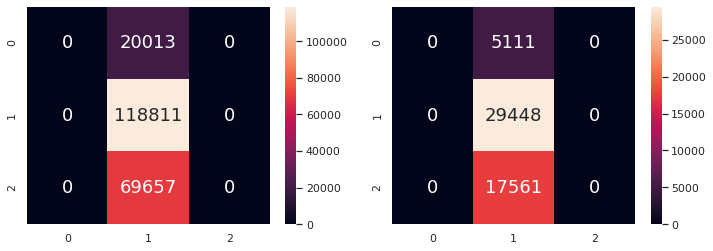

In [0]:
#Import scikit-learn metrics module for accuracy calculation
from sklearn.naive_bayes import GaussianNB
from sklearn import metrics
from sklearn.metrics import classification_report


# Extract Response and Predictors
ylasty = pd.DataFrame(df3['damage_grade'])
Xlasty = pd.DataFrame(numericdata['has_secondary_use'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X_train, X_test, y_train, y_test = train_test_split(Xlasty, ylasty, test_size = no)


#Create a Gaussian Classifier and #rain the model using the training sets
gnb = GaussianNB()
gnb.fit(X_train, y_train.values.ravel())



#Predict the response for train & test dataset
y_train_pred = gnb.predict(X_train)
y_test_pred = gnb.predict(X_test)
 

#Import scikit-learn metrics module for accuracy calculation
from sklearn import metrics

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", gnb.score(X_train, y_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", gnb.score(X_test, y_test))
print()


# Model Accuracy, how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, y_test_pred))
print(classification_report(y_train, y_train_pred))
print(classification_report(y_test, y_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y_train, y_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y_test, y_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

In [0]:
#has_secondary_use_agriculture

Train Size: 208481
Testing Size: 52120
Total Size: 260601
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.5697305749684624

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.5656369915579432

              precision    recall  f1-score   support

           1       0.00      0.00      0.00      5010
           2       0.57      1.00      0.72     29481
           3       0.00      0.00      0.00     17629

    accuracy                           0.57     52120
   macro avg       0.19      0.33      0.24     52120
weighted avg       0.32      0.57      0.41     52120



/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


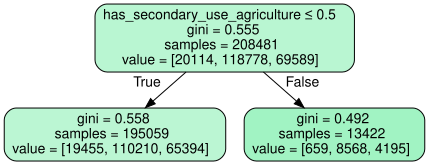

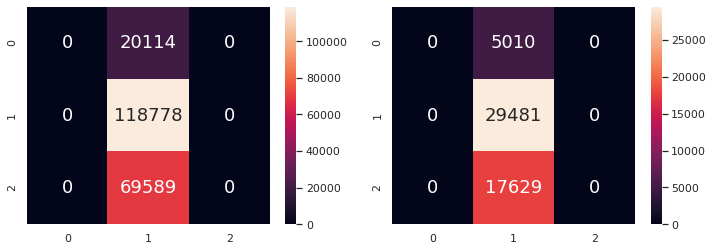

In [0]:
# Import essential models and functions from sklearn
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.tree import export_graphviz
import graphviz

# Extract Response and Predictors
y9b = pd.DataFrame(numtrain['damage_grade'])
X9b = pd.DataFrame(numtrain['has_secondary_use_agriculture'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X9b_train, X9b_test, y9b_train, y9b_test = train_test_split(X9b, y9b, test_size = no)

# Decision Tree using Train Data
dectree = DecisionTreeClassifier(max_depth = 4)  # create the decision tree object
dectree.fit(X9b_train, y9b_train)                    # train the decision tree model

# Predict Response corresponding to Predictors
y9b_train_pred = dectree.predict(X9b_train)
y9b_test_pred = dectree.predict(X9b_test)

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", dectree.score(X9b_train, y9b_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", dectree.score(X9b_test, y9b_test))
print()

#Classification Metrics
from sklearn.metrics import classification_report

print(classification_report(y9b_test, y9b_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y9b_train, y9b_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y9b_test, y9b_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

# Plot the Decision Tree
treedot = export_graphviz(dectree,                                      # the model
                          feature_names = X9b_train.columns,              # the features 
                          out_file = None,                              # output file
                          filled = True,                                # node colors
                          rounded = True,                               # make pretty
                          special_characters = True)                    # postscript

graphviz.Source(treedot)


Train Size: 208481
Testing Size: 52120
Total Size: 260601
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.56906864414503

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.5682847275518035

Accuracy: 0.5682847275518035


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



              precision    recall  f1-score   support

           1       0.00      0.00      0.00     20223
           2       0.57      1.00      0.73    118640
           3       0.00      0.00      0.00     69618

    accuracy                           0.57    208481
   macro avg       0.19      0.33      0.24    208481
weighted avg       0.32      0.57      0.41    208481

              precision    recall  f1-score   support

           1       0.00      0.00      0.00      4901
           2       0.57      1.00      0.72     29619
           3       0.00      0.00      0.00     17600

    accuracy                           0.57     52120
   macro avg       0.19      0.33      0.24     52120
weighted avg       0.32      0.57      0.41     52120



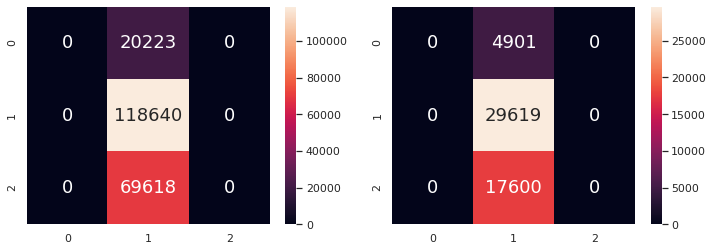

In [0]:
#Import scikit-learn metrics module for accuracy calculation
from sklearn.naive_bayes import GaussianNB
from sklearn import metrics
from sklearn.metrics import classification_report


# Extract Response and Predictors
ylasty = pd.DataFrame(df3['damage_grade'])
Xlasty = pd.DataFrame(numericdata['has_secondary_use_agriculture'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X_train, X_test, y_train, y_test = train_test_split(Xlasty, ylasty, test_size = no)


#Create a Gaussian Classifier and #rain the model using the training sets
gnb = GaussianNB()
gnb.fit(X_train, y_train.values.ravel())



#Predict the response for train & test dataset
y_train_pred = gnb.predict(X_train)
y_test_pred = gnb.predict(X_test)
 

#Import scikit-learn metrics module for accuracy calculation
from sklearn import metrics

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", gnb.score(X_train, y_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", gnb.score(X_test, y_test))
print()


# Model Accuracy, how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, y_test_pred))
print(classification_report(y_train, y_train_pred))
print(classification_report(y_test, y_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y_train, y_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y_test, y_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

In [0]:
#has_secondary_use_hotel

Train Size: 208481
Testing Size: 52120
Total Size: 260601
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.5695674905626892

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.5662893323100537

              precision    recall  f1-score   support

           1       0.00      0.00      0.00      5045
           2       0.57      1.00      0.72     29515
           3       0.00      0.00      0.00     17560

    accuracy                           0.57     52120
   macro avg       0.19      0.33      0.24     52120
weighted avg       0.32      0.57      0.41     52120



/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


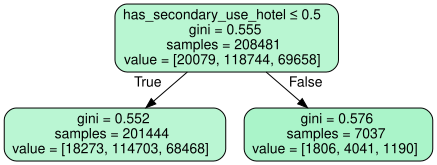

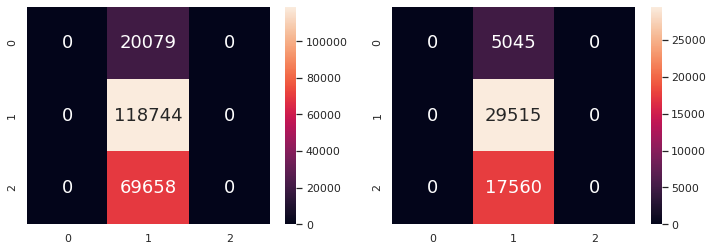

In [0]:
# Import essential models and functions from sklearn
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.tree import export_graphviz
import graphviz

# Extract Response and Predictors
y9c = pd.DataFrame(numtrain['damage_grade'])
X9c = pd.DataFrame(numtrain['has_secondary_use_hotel'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X9c_train, X9c_test, y9c_train, y9c_test = train_test_split(X9c, y9c, test_size = no)

# Decision Tree using Train Data
dectree = DecisionTreeClassifier(max_depth = 4)  # create the decision tree object
dectree.fit(X9c_train, y9c_train)                    # train the decision tree model

# Predict Response corresponding to Predictors
y9c_train_pred = dectree.predict(X9c_train)
y9c_test_pred = dectree.predict(X9c_test)

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", dectree.score(X9c_train, y9c_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", dectree.score(X9c_test, y9c_test))
print()

#Classification Metrics
from sklearn.metrics import classification_report

print(classification_report(y9c_test, y9c_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y9c_train, y9c_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y9c_test, y9c_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

# Plot the Decision Tree
treedot = export_graphviz(dectree,                                      # the model
                          feature_names = X9c_train.columns,              # the features 
                          out_file = None,                              # output file
                          filled = True,                                # node colors
                          rounded = True,                               # make pretty
                          special_characters = True)                    # postscript

graphviz.Source(treedot)


Train Size: 208481
Testing Size: 52120
Total Size: 260601
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.5579693113521136

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.5581542594013814

Accuracy: 0.5581542594013814


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



              precision    recall  f1-score   support

           1       0.25      0.09      0.13     20019
           2       0.57      0.97      0.72    118628
           3       0.00      0.00      0.00     69834

    accuracy                           0.56    208481
   macro avg       0.27      0.35      0.28    208481
weighted avg       0.35      0.56      0.42    208481

              precision    recall  f1-score   support

           1       0.25      0.08      0.12      5105
           2       0.57      0.97      0.72     29631
           3       0.00      0.00      0.00     17384

    accuracy                           0.56     52120
   macro avg       0.27      0.35      0.28     52120
weighted avg       0.35      0.56      0.42     52120



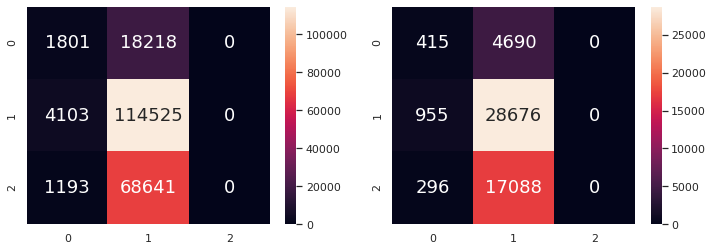

In [0]:
#Import scikit-learn metrics module for accuracy calculation
from sklearn.naive_bayes import GaussianNB
from sklearn import metrics
from sklearn.metrics import classification_report


# Extract Response and Predictors
ylasty = pd.DataFrame(df3['damage_grade'])
Xlasty = pd.DataFrame(numericdata['has_secondary_use_hotel'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X_train, X_test, y_train, y_test = train_test_split(Xlasty, ylasty, test_size = no)


#Create a Gaussian Classifier and #rain the model using the training sets
gnb = GaussianNB()
gnb.fit(X_train, y_train.values.ravel())



#Predict the response for train & test dataset
y_train_pred = gnb.predict(X_train)
y_test_pred = gnb.predict(X_test)
 

#Import scikit-learn metrics module for accuracy calculation
from sklearn import metrics

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", gnb.score(X_train, y_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", gnb.score(X_test, y_test))
print()


# Model Accuracy, how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, y_test_pred))
print(classification_report(y_train, y_train_pred))
print(classification_report(y_test, y_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y_train, y_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y_test, y_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

In [0]:
#has_secondary_use_rental

Train Size: 208481
Testing Size: 52120
Total Size: 260601
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.5691118135465582

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.5681120491174213

              precision    recall  f1-score   support

           1       0.00      0.00      0.00      5053
           2       0.57      1.00      0.72     29610
           3       0.00      0.00      0.00     17457

    accuracy                           0.57     52120
   macro avg       0.19      0.33      0.24     52120
weighted avg       0.32      0.57      0.41     52120



/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


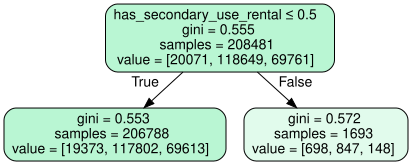

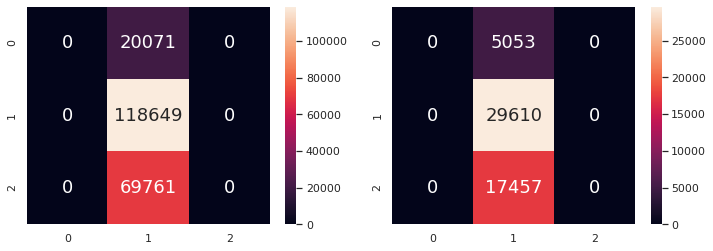

In [0]:
# Import essential models and functions from sklearn
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.tree import export_graphviz
import graphviz

# Extract Response and Predictors
y9d = pd.DataFrame(numtrain['damage_grade'])
X9d = pd.DataFrame(numtrain['has_secondary_use_rental'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X9d_train, X9d_test, y9d_train, y9d_test = train_test_split(X9d, y9d, test_size = no)

# Decision Tree using Train Data
dectree = DecisionTreeClassifier(max_depth = 4)  # create the decision tree object
dectree.fit(X9d_train, y9d_train)                    # train the decision tree model

# Predict Response corresponding to Predictors
y9d_train_pred = dectree.predict(X9d_train)
y9d_test_pred = dectree.predict(X9d_test)

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", dectree.score(X9d_train, y9d_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", dectree.score(X9d_test, y9d_test))
print()

#Classification Metrics
from sklearn.metrics import classification_report

print(classification_report(y9d_test, y9d_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y9d_train, y9d_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y9d_test, y9d_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

# Plot the Decision Tree
treedot = export_graphviz(dectree,                                      # the model
                          feature_names = X9d_train.columns,              # the features 
                          out_file = None,                              # output file
                          filled = True,                                # node colors
                          rounded = True,                               # make pretty
                          special_characters = True)                    # postscript

graphviz.Source(treedot)


Train Size: 208481
Testing Size: 52120
Total Size: 260601
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.3371098565336889

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.3382770529547199

Accuracy: 0.3382770529547199


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



              precision    recall  f1-score   support

           1       0.41      0.03      0.06     20102
           2       0.00      0.00      0.00    118641
           3       0.34      1.00      0.50     69738

    accuracy                           0.34    208481
   macro avg       0.25      0.34      0.19    208481
weighted avg       0.15      0.34      0.17    208481

              precision    recall  f1-score   support

           1       0.45      0.04      0.07      5022
           2       0.00      0.00      0.00     29618
           3       0.34      1.00      0.50     17480

    accuracy                           0.34     52120
   macro avg       0.26      0.34      0.19     52120
weighted avg       0.16      0.34      0.18     52120



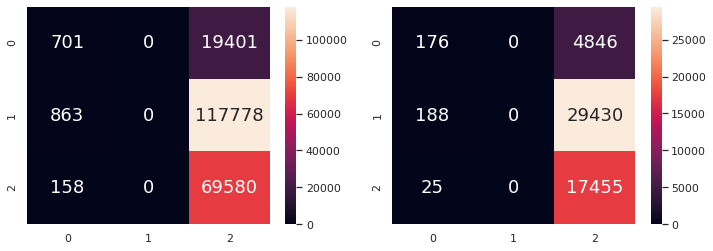

In [0]:
#Import scikit-learn metrics module for accuracy calculation
from sklearn.naive_bayes import GaussianNB
from sklearn import metrics
from sklearn.metrics import classification_report


# Extract Response and Predictors
ylasty = pd.DataFrame(df3['damage_grade'])
Xlasty = pd.DataFrame(numericdata['has_secondary_use_rental'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X_train, X_test, y_train, y_test = train_test_split(Xlasty, ylasty, test_size = no)


#Create a Gaussian Classifier and #rain the model using the training sets
gnb = GaussianNB()
gnb.fit(X_train, y_train.values.ravel())



#Predict the response for train & test dataset
y_train_pred = gnb.predict(X_train)
y_test_pred = gnb.predict(X_test)
 

#Import scikit-learn metrics module for accuracy calculation
from sklearn import metrics

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", gnb.score(X_train, y_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", gnb.score(X_test, y_test))
print()


# Model Accuracy, how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, y_test_pred))
print(classification_report(y_train, y_train_pred))
print(classification_report(y_test, y_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y_train, y_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y_test, y_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

In [0]:
#has_secondary_use_institution

Train Size: 208481
Testing Size: 52120
Total Size: 260601
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.5690494577443508

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.5683614735226401

              precision    recall  f1-score   support

           1       0.00      0.00      0.00      4961
           2       0.57      1.00      0.72     29623
           3       0.00      0.00      0.00     17536

    accuracy                           0.57     52120
   macro avg       0.19      0.33      0.24     52120
weighted avg       0.32      0.57      0.41     52120



/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


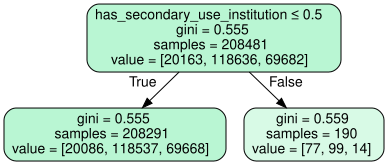

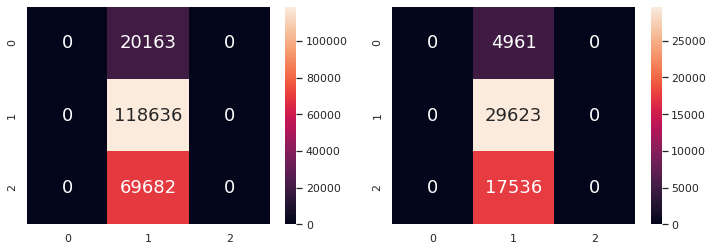

In [0]:
# Import essential models and functions from sklearn
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.tree import export_graphviz
import graphviz

# Extract Response and Predictors
y9e = pd.DataFrame(numtrain['damage_grade'])
X9e = pd.DataFrame(numtrain['has_secondary_use_institution'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X9e_train, X9e_test, y9e_train, y9e_test = train_test_split(X9e, y9e, test_size = no)

# Decision Tree using Train Data
dectree = DecisionTreeClassifier(max_depth = 4)  # create the decision tree object
dectree.fit(X9e_train, y9e_train)                    # train the decision tree model

# Predict Response corresponding to Predictors
y9e_train_pred = dectree.predict(X9e_train)
y9e_test_pred = dectree.predict(X9e_test)

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", dectree.score(X9e_train, y9e_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", dectree.score(X9e_test, y9e_test))
print()

#Classification Metrics
from sklearn.metrics import classification_report

print(classification_report(y9e_test, y9e_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y9e_train, y9e_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y9e_test, y9e_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

# Plot the Decision Tree
treedot = export_graphviz(dectree,                                      # the model
                          feature_names = X9e_train.columns,              # the features 
                          out_file = None,                              # output file
                          filled = True,                                # node colors
                          rounded = True,                               # make pretty
                          special_characters = True)                    # postscript

graphviz.Source(treedot)


Train Size: 208481
Testing Size: 52120
Total Size: 260601
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.3348362680532039

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.33562931696085957

Accuracy: 0.33562931696085957


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



              precision    recall  f1-score   support

           1       0.38      0.00      0.01     20148
           2       0.00      0.00      0.00    118585
           3       0.33      1.00      0.50     69748

    accuracy                           0.33    208481
   macro avg       0.24      0.33      0.17    208481
weighted avg       0.15      0.33      0.17    208481

              precision    recall  f1-score   support

           1       0.48      0.00      0.01      4976
           2       0.00      0.00      0.00     29674
           3       0.34      1.00      0.50     17470

    accuracy                           0.34     52120
   macro avg       0.27      0.33      0.17     52120
weighted avg       0.16      0.34      0.17     52120



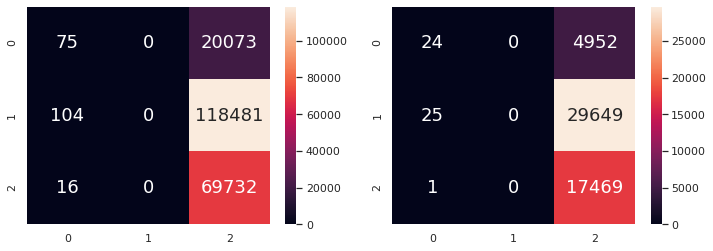

In [0]:
#Import scikit-learn metrics module for accuracy calculation
from sklearn.naive_bayes import GaussianNB
from sklearn import metrics
from sklearn.metrics import classification_report


# Extract Response and Predictors
ylasty = pd.DataFrame(df3['damage_grade'])
Xlasty = pd.DataFrame(numericdata['has_secondary_use_institution'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X_train, X_test, y_train, y_test = train_test_split(Xlasty, ylasty, test_size = no)


#Create a Gaussian Classifier and #rain the model using the training sets
gnb = GaussianNB()
gnb.fit(X_train, y_train.values.ravel())



#Predict the response for train & test dataset
y_train_pred = gnb.predict(X_train)
y_test_pred = gnb.predict(X_test)
 

#Import scikit-learn metrics module for accuracy calculation
from sklearn import metrics

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", gnb.score(X_train, y_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", gnb.score(X_test, y_test))
print()


# Model Accuracy, how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, y_test_pred))
print(classification_report(y_train, y_train_pred))
print(classification_report(y_test, y_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y_train, y_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y_test, y_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

In [0]:
#has_secondary_use_industry

Train Size: 208481
Testing Size: 52120
Total Size: 260601
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.5683539507197298

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.5711435149654643

              precision    recall  f1-score   support

           1       0.00      0.00      0.00      5063
           2       0.57      1.00      0.73     29768
           3       0.00      0.00      0.00     17289

    accuracy                           0.57     52120
   macro avg       0.19      0.33      0.24     52120
weighted avg       0.33      0.57      0.42     52120



/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


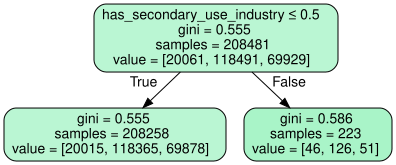

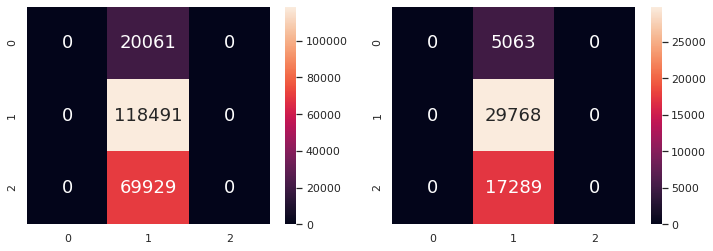

In [0]:
# Import essential models and functions from sklearn
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.tree import export_graphviz
import graphviz

# Extract Response and Predictors
ya = pd.DataFrame(numtrain['damage_grade'])
Xa = pd.DataFrame(numtrain['has_secondary_use_industry'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
Xa_train, Xa_test, ya_train, ya_test = train_test_split(Xa, ya, test_size = no)

# Decision Tree using Train Data
dectree = DecisionTreeClassifier(max_depth = 4)  # create the decision tree object
dectree.fit(Xa_train, ya_train)                    # train the decision tree model

# Predict Response corresponding to Predictors
ya_train_pred = dectree.predict(Xa_train)
ya_test_pred = dectree.predict(Xa_test)

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", dectree.score(Xa_train, ya_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", dectree.score(Xa_test, ya_test))
print()

#Classification Metrics
from sklearn.metrics import classification_report

print(classification_report(ya_test, ya_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(ya_train, ya_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(ya_test, ya_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

# Plot the Decision Tree
treedot = export_graphviz(dectree,                                      # the model
                          feature_names = Xa_train.columns,              # the features 
                          out_file = None,                              # output file
                          filled = True,                                # node colors
                          rounded = True,                               # make pretty
                          special_characters = True)                    # postscript

graphviz.Source(treedot)


In [0]:
#Import scikit-learn metrics module for accuracy calculation
from sklearn.naive_bayes import GaussianNB
from sklearn import metrics
from sklearn.metrics import classification_report


# Extract Response and Predictors
ylasty = pd.DataFrame(df3['damage_grade'])
Xlasty = pd.DataFrame(numericdata['has_secondary_use_industry'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X_train, X_test, y_train, y_test = train_test_split(Xlasty, ylasty, test_size = no)


#Create a Gaussian Classifier and #rain the model using the training sets
gnb = GaussianNB()
gnb.fit(X_train, y_train.values.ravel())



#Predict the response for train & test dataset
y_train_pred = gnb.predict(X_train)
y_test_pred = gnb.predict(X_test)
 

#Import scikit-learn metrics module for accuracy calculation
from sklearn import metrics

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", gnb.score(X_train, y_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", gnb.score(X_test, y_test))
print()


# Model Accuracy, how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, y_test_pred))
print(classification_report(y_train, y_train_pred))
print(classification_report(y_test, y_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y_train, y_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y_test, y_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

In [0]:
#has_secondary_use_school

Train Size: 208481
Testing Size: 52120
Total Size: 260601
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.5695051347604818

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.5665387567152724

              precision    recall  f1-score   support

           1       0.00      0.00      0.00      5095
           2       0.57      1.00      0.72     29528
           3       0.00      0.00      0.00     17497

    accuracy                           0.57     52120
   macro avg       0.19      0.33      0.24     52120
weighted avg       0.32      0.57      0.41     52120



/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


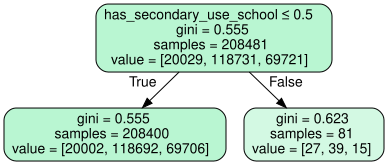

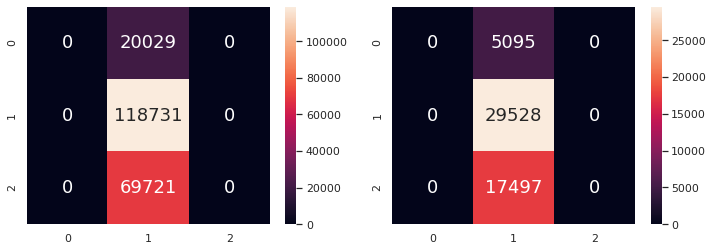

In [0]:
# Import essential models and functions from sklearn
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.tree import export_graphviz
import graphviz

# Extract Response and Predictors
yb = pd.DataFrame(numtrain['damage_grade'])
Xb = pd.DataFrame(numtrain['has_secondary_use_school'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
Xb_train, Xb_test, yb_train, yb_test = train_test_split(Xb, yb, test_size = no)

# Decision Tree using Train Data
dectree = DecisionTreeClassifier(max_depth = 4)  # create the decision tree object
dectree.fit(Xb_train, yb_train)                    # train the decision tree model

# Predict Response corresponding to Predictors
yb_train_pred = dectree.predict(Xb_train)
yb_test_pred = dectree.predict(Xb_test)

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", dectree.score(Xb_train, yb_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", dectree.score(Xb_test, yb_test))
print()

#Classification Metrics
from sklearn.metrics import classification_report

print(classification_report(yb_test, yb_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(yb_train, yb_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(yb_test, yb_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

# Plot the Decision Tree
treedot = export_graphviz(dectree,                                      # the model
                          feature_names = Xb_train.columns,              # the features 
                          out_file = None,                              # output file
                          filled = True,                                # node colors
                          rounded = True,                               # make pretty
                          special_characters = True)                    # postscript

graphviz.Source(treedot)


Train Size: 208481
Testing Size: 52120
Total Size: 260601
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.5692748979523314

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.5671335379892556

Accuracy: 0.5671335379892556


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



              precision    recall  f1-score   support

           1       0.29      0.00      0.00     20103
           2       0.57      1.00      0.73    118701
           3       0.00      0.00      0.00     69677

    accuracy                           0.57    208481
   macro avg       0.29      0.33      0.24    208481
weighted avg       0.35      0.57      0.41    208481

              precision    recall  f1-score   support

           1       0.50      0.00      0.00      5021
           2       0.57      1.00      0.72     29558
           3       0.00      0.00      0.00     17541

    accuracy                           0.57     52120
   macro avg       0.36      0.33      0.24     52120
weighted avg       0.37      0.57      0.41     52120



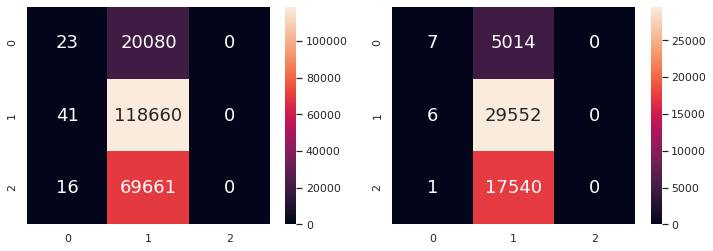

In [0]:
#Import scikit-learn metrics module for accuracy calculation
from sklearn.naive_bayes import GaussianNB
from sklearn import metrics
from sklearn.metrics import classification_report


# Extract Response and Predictors
ylasty = pd.DataFrame(df3['damage_grade'])
Xlasty = pd.DataFrame(numericdata['has_secondary_use_school'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X_train, X_test, y_train, y_test = train_test_split(Xlasty, ylasty, test_size = no)


#Create a Gaussian Classifier and #rain the model using the training sets
gnb = GaussianNB()
gnb.fit(X_train, y_train.values.ravel())



#Predict the response for train & test dataset
y_train_pred = gnb.predict(X_train)
y_test_pred = gnb.predict(X_test)
 

#Import scikit-learn metrics module for accuracy calculation
from sklearn import metrics

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", gnb.score(X_train, y_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", gnb.score(X_test, y_test))
print()


# Model Accuracy, how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, y_test_pred))
print(classification_report(y_train, y_train_pred))
print(classification_report(y_test, y_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y_train, y_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y_test, y_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

In [0]:
#has_secondary_use_health_post

Train Size: 208481
Testing Size: 52120
Total Size: 260601
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.5689439325406153

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.568783576362241

              precision    recall  f1-score   support

           1       0.00      0.00      0.00      4986
           2       0.57      1.00      0.73     29645
           3       0.00      0.00      0.00     17489

    accuracy                           0.57     52120
   macro avg       0.19      0.33      0.24     52120
weighted avg       0.32      0.57      0.41     52120



/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


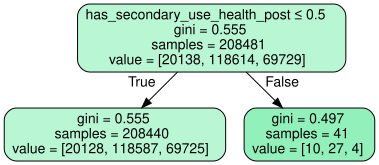

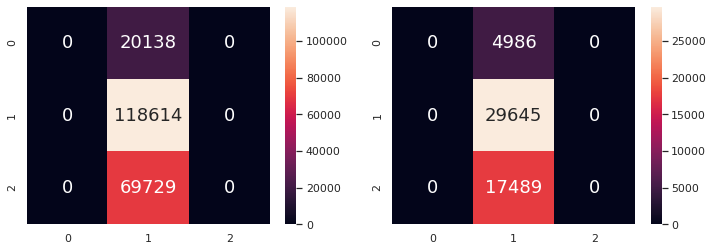

In [0]:
# Import essential models and functions from sklearn
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.tree import export_graphviz
import graphviz

# Extract Response and Predictors
yc = pd.DataFrame(numtrain['damage_grade'])
Xc = pd.DataFrame(numtrain['has_secondary_use_health_post'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
Xc_train, Xc_test, yc_train, yc_test = train_test_split(Xc, yc, test_size = no)

# Decision Tree using Train Data
dectree = DecisionTreeClassifier(max_depth = 4)  # create the decision tree object
dectree.fit(Xc_train, yc_train)                    # train the decision tree model

# Predict Response corresponding to Predictors
yc_train_pred = dectree.predict(X9c_train)
yc_test_pred = dectree.predict(X9c_test)

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", dectree.score(Xc_train, yc_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", dectree.score(Xc_test, yc_test))
print()

#Classification Metrics
from sklearn.metrics import classification_report

print(classification_report(yc_test, yc_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(yc_train, yc_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(yc_test, yc_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

# Plot the Decision Tree
treedot = export_graphviz(dectree,                                      # the model
                          feature_names = Xc_train.columns,              # the features 
                          out_file = None,                              # output file
                          filled = True,                                # node colors
                          rounded = True,                               # make pretty
                          special_characters = True)                    # postscript

graphviz.Source(treedot)


Train Size: 208481
Testing Size: 52120
Total Size: 260601
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.3348218782526945

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.334247889485802

Accuracy: 0.334247889485802


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



              precision    recall  f1-score   support

           1       0.24      0.00      0.00     20110
           2       0.00      0.00      0.00    118574
           3       0.33      1.00      0.50     69797

    accuracy                           0.33    208481
   macro avg       0.19      0.33      0.17    208481
weighted avg       0.14      0.33      0.17    208481

              precision    recall  f1-score   support

           1       0.25      0.00      0.00      5014
           2       0.00      0.00      0.00     29685
           3       0.33      1.00      0.50     17421

    accuracy                           0.33     52120
   macro avg       0.19      0.33      0.17     52120
weighted avg       0.14      0.33      0.17     52120



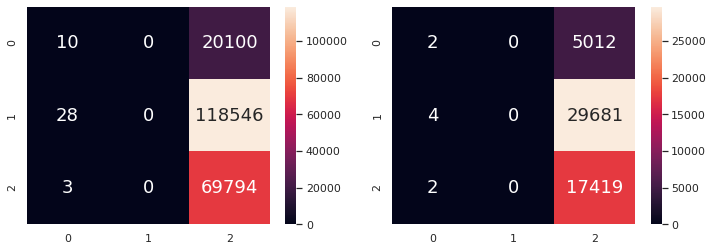

In [0]:
#Import scikit-learn metrics module for accuracy calculation
from sklearn.naive_bayes import GaussianNB
from sklearn import metrics
from sklearn.metrics import classification_report


# Extract Response and Predictors
ylasty = pd.DataFrame(df3['damage_grade'])
Xlasty = pd.DataFrame(numericdata['has_secondary_use_health_post'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X_train, X_test, y_train, y_test = train_test_split(Xlasty, ylasty, test_size = no)


#Create a Gaussian Classifier and #rain the model using the training sets
gnb = GaussianNB()
gnb.fit(X_train, y_train.values.ravel())



#Predict the response for train & test dataset
y_train_pred = gnb.predict(X_train)
y_test_pred = gnb.predict(X_test)
 

#Import scikit-learn metrics module for accuracy calculation
from sklearn import metrics

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", gnb.score(X_train, y_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", gnb.score(X_test, y_test))
print()


# Model Accuracy, how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, y_test_pred))
print(classification_report(y_train, y_train_pred))
print(classification_report(y_test, y_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y_train, y_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y_test, y_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

In [0]:
#has_secondary_use_gov_office

Train Size: 208481
Testing Size: 52120
Total Size: 260601
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.5689439325406153

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.568783576362241

              precision    recall  f1-score   support

           1       0.00      0.00      0.00      5065
           2       0.57      1.00      0.73     29645
           3       0.00      0.00      0.00     17410

    accuracy                           0.57     52120
   macro avg       0.19      0.33      0.24     52120
weighted avg       0.32      0.57      0.41     52120



/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


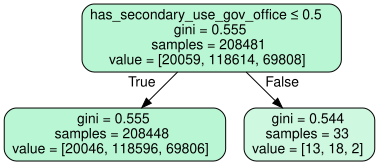

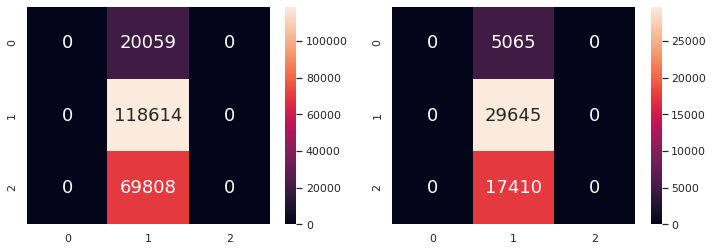

In [0]:
# Import essential models and functions from sklearn
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.tree import export_graphviz
import graphviz

# Extract Response and Predictors
yd = pd.DataFrame(numtrain['damage_grade'])
Xd = pd.DataFrame(numtrain['has_secondary_use_gov_office'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
Xd_train, Xd_test, yd_train, yd_test = train_test_split(Xd, yd, test_size = no)

# Decision Tree using Train Data
dectree = DecisionTreeClassifier(max_depth = 4)  # create the decision tree object
dectree.fit(Xd_train, yd_train)                    # train the decision tree model

# Predict Response corresponding to Predictors
yd_train_pred = dectree.predict(X9d_train)
yd_test_pred = dectree.predict(X9d_test)

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", dectree.score(Xd_train, yd_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", dectree.score(Xd_test, yd_test))
print()

#Classification Metrics
from sklearn.metrics import classification_report

print(classification_report(yd_test, yd_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(yd_train, yd_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(yd_test, yd_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

# Plot the Decision Tree
treedot = export_graphviz(dectree,                                      # the model
                          feature_names = Xd_train.columns,              # the features 
                          out_file = None,                              # output file
                          filled = True,                                # node colors
                          rounded = True,                               # make pretty
                          special_characters = True)                    # postscript

graphviz.Source(treedot)


Train Size: 208481
Testing Size: 52120
Total Size: 260601
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.3347835054513361

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.3344397544128933

Accuracy: 0.3344397544128933


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



              precision    recall  f1-score   support

           1       0.33      0.00      0.00     20103
           2       0.00      0.00      0.00    118589
           3       0.33      1.00      0.50     69789

    accuracy                           0.33    208481
   macro avg       0.22      0.33      0.17    208481
weighted avg       0.14      0.33      0.17    208481

              precision    recall  f1-score   support

           1       0.38      0.00      0.00      5021
           2       0.00      0.00      0.00     29670
           3       0.33      1.00      0.50     17429

    accuracy                           0.33     52120
   macro avg       0.24      0.33      0.17     52120
weighted avg       0.15      0.33      0.17     52120



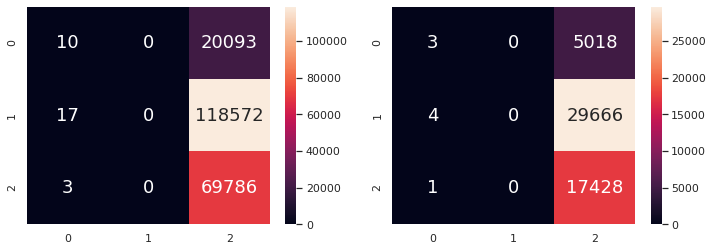

In [0]:
#Import scikit-learn metrics module for accuracy calculation
from sklearn.naive_bayes import GaussianNB
from sklearn import metrics
from sklearn.metrics import classification_report


# Extract Response and Predictors
ylasty = pd.DataFrame(df3['damage_grade'])
Xlasty = pd.DataFrame(numericdata['has_secondary_use_gov_office'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X_train, X_test, y_train, y_test = train_test_split(Xlasty, ylasty, test_size = no)


#Create a Gaussian Classifier and #rain the model using the training sets
gnb = GaussianNB()
gnb.fit(X_train, y_train.values.ravel())



#Predict the response for train & test dataset
y_train_pred = gnb.predict(X_train)
y_test_pred = gnb.predict(X_test)
 

#Import scikit-learn metrics module for accuracy calculation
from sklearn import metrics

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", gnb.score(X_train, y_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", gnb.score(X_test, y_test))
print()


# Model Accuracy, how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, y_test_pred))
print(classification_report(y_train, y_train_pred))
print(classification_report(y_test, y_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y_train, y_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y_test, y_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

In [0]:
#has_secondary_use_use_police

Train Size: 208481
Testing Size: 52120
Total Size: 260601
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.5691214067468978

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.5680736761320031

              precision    recall  f1-score   support

           1       0.00      0.00      0.00      5007
           2       0.57      1.00      0.72     29608
           3       0.00      0.00      0.00     17505

    accuracy                           0.57     52120
   macro avg       0.19      0.33      0.24     52120
weighted avg       0.32      0.57      0.41     52120



/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


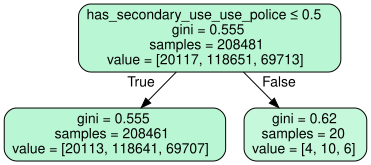

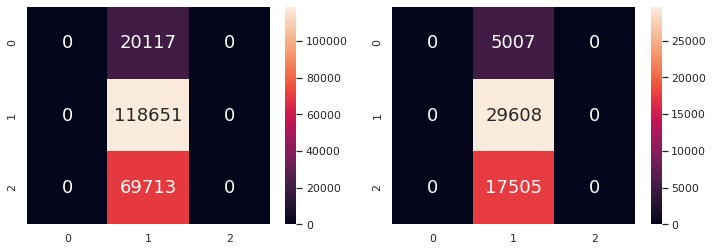

In [0]:
# Import essential models and functions from sklearn
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.tree import export_graphviz
import graphviz

# Extract Response and Predictors
ye = pd.DataFrame(numtrain['damage_grade'])
Xe = pd.DataFrame(numtrain['has_secondary_use_use_police'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
Xe_train, Xe_test, ye_train, ye_test = train_test_split(Xe, ye, test_size = no)

# Decision Tree using Train Data
dectree = DecisionTreeClassifier(max_depth = 4)  # create the decision tree object
dectree.fit(Xe_train, ye_train)                    # train the decision tree model

# Predict Response corresponding to Predictors
ye_train_pred = dectree.predict(Xe_train)
ye_test_pred = dectree.predict(Xe_test)

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", dectree.score(Xe_train, ye_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", dectree.score(Xe_test, ye_test))
print()

#Classification Metrics
from sklearn.metrics import classification_report

print(classification_report(ye_test, ye_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(ye_train, ye_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(ye_test, ye_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

# Plot the Decision Tree
treedot = export_graphviz(dectree,                                      # the model
                          feature_names = Xe_train.columns,              # the features 
                          out_file = None,                              # output file
                          filled = True,                                # node colors
                          rounded = True,                               # make pretty
                          special_characters = True)                    # postscript

graphviz.Source(treedot)


Train Size: 208481
Testing Size: 52120
Total Size: 260601
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.5688336107367098

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.569071373752878

Accuracy: 0.569071373752878


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



              precision    recall  f1-score   support

           1       0.19      0.00      0.00     20062
           2       0.57      1.00      0.73    118599
           3       0.00      0.00      0.00     69820

    accuracy                           0.57    208481
   macro avg       0.25      0.33      0.24    208481
weighted avg       0.34      0.57      0.41    208481

              precision    recall  f1-score   support

           1       0.00      0.00      0.00      5062
           2       0.57      1.00      0.73     29660
           3       0.00      0.00      0.00     17398

    accuracy                           0.57     52120
   macro avg       0.19      0.33      0.24     52120
weighted avg       0.32      0.57      0.41     52120



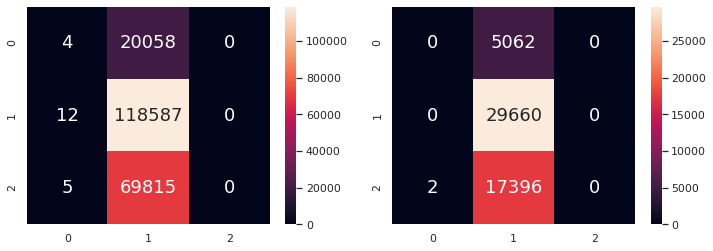

In [0]:
#Import scikit-learn metrics module for accuracy calculation
from sklearn.naive_bayes import GaussianNB
from sklearn import metrics
from sklearn.metrics import classification_report


# Extract Response and Predictors
ylasty = pd.DataFrame(df3['damage_grade'])
Xlasty = pd.DataFrame(numericdata['has_secondary_use_use_police'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X_train, X_test, y_train, y_test = train_test_split(Xlasty, ylasty, test_size = no)


#Create a Gaussian Classifier and #rain the model using the training sets
gnb = GaussianNB()
gnb.fit(X_train, y_train.values.ravel())



#Predict the response for train & test dataset
y_train_pred = gnb.predict(X_train)
y_test_pred = gnb.predict(X_test)
 

#Import scikit-learn metrics module for accuracy calculation
from sklearn import metrics

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", gnb.score(X_train, y_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", gnb.score(X_test, y_test))
print()


# Model Accuracy, how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, y_test_pred))
print(classification_report(y_train, y_train_pred))
print(classification_report(y_test, y_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y_train, y_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y_test, y_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

In [0]:
#has_secondary_use_other

Train Size: 208481
Testing Size: 52120
Total Size: 260601
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.5685074419251634

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.570529547198772

              precision    recall  f1-score   support

           1       0.00      0.00      0.00      4934
           2       0.57      1.00      0.73     29736
           3       0.00      0.00      0.00     17450

    accuracy                           0.57     52120
   macro avg       0.19      0.33      0.24     52120
weighted avg       0.33      0.57      0.41     52120



/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


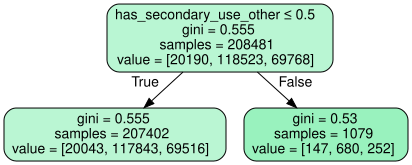

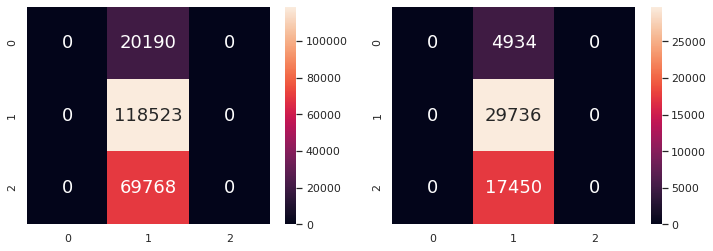

In [0]:
# Import essential models and functions from sklearn
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.tree import export_graphviz
import graphviz

# Extract Response and Predictors
yf = pd.DataFrame(df3['damage_grade'])
Xf = pd.DataFrame(numtrain['has_secondary_use_other'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
Xf_train, Xf_test, yf_train, yf_test = train_test_split(Xf, yf, test_size = no)

# Decision Tree using Train Data
dectree = DecisionTreeClassifier(max_depth = 4)  # create the decision tree object
dectree.fit(Xf_train, yf_train)                    # train the decision tree model

# Predict Response corresponding to Predictors
yf_train_pred = dectree.predict(Xf_train)
yf_test_pred = dectree.predict(Xf_test)

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", dectree.score(Xf_train, yf_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", dectree.score(Xf_test, yf_test))
print()

#Classification Metrics
from sklearn.metrics import classification_report

print(classification_report(yf_test, yf_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(yf_train, yf_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(yf_test, yf_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

# Plot the Decision Tree
treedot = export_graphviz(dectree,                                      # the model
                          feature_names = Xf_train.columns,              # the features 
                          out_file = None,                              # output file
                          filled = True,                                # node colors
                          rounded = True,                               # make pretty
                          special_characters = True)                    # postscript

graphviz.Source(treedot)

Train Size: 208481
Testing Size: 52120
Total Size: 260601
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.5671260210762612

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.5630660015349194

Accuracy: 0.5630660015349194


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



              precision    recall  f1-score   support

           1       0.13      0.01      0.01     20051
           2       0.57      0.99      0.72    118759
           3       0.00      0.00      0.00     69671

    accuracy                           0.57    208481
   macro avg       0.23      0.33      0.25    208481
weighted avg       0.34      0.57      0.41    208481

              precision    recall  f1-score   support

           1       0.15      0.01      0.02      5073
           2       0.57      0.99      0.72     29500
           3       0.00      0.00      0.00     17547

    accuracy                           0.56     52120
   macro avg       0.24      0.33      0.25     52120
weighted avg       0.33      0.56      0.41     52120



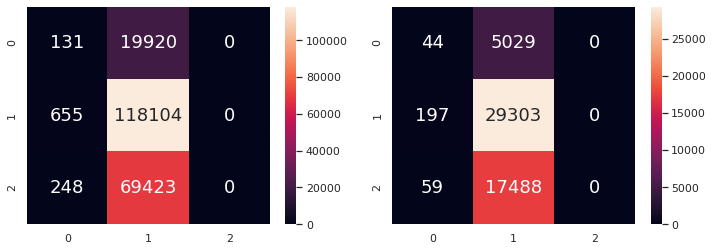

In [0]:
#Import scikit-learn metrics module for accuracy calculation
from sklearn.naive_bayes import GaussianNB
from sklearn import metrics
from sklearn.metrics import classification_report


# Extract Response and Predictors
ylasty = pd.DataFrame(df3['damage_grade'])
Xlasty = pd.DataFrame(numericdata['has_secondary_use_other'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X_train, X_test, y_train, y_test = train_test_split(Xlasty, ylasty, test_size = no)


#Create a Gaussian Classifier and #rain the model using the training sets
gnb = GaussianNB()
gnb.fit(X_train, y_train.values.ravel())



#Predict the response for train & test dataset
y_train_pred = gnb.predict(X_train)
y_test_pred = gnb.predict(X_test)
 

#Import scikit-learn metrics module for accuracy calculation
from sklearn import metrics

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", gnb.score(X_train, y_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", gnb.score(X_test, y_test))
print()


# Model Accuracy, how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, y_test_pred))
print(classification_report(y_train, y_train_pred))
print(classification_report(y_test, y_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y_train, y_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y_test, y_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

In [0]:
#All numericdata

Train Size: 208481
Testing Size: 52120
Total Size: 260601
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.6256877125493451

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.6263238679969302

              precision    recall  f1-score   support

           1       0.54      0.23      0.32      5009
           2       0.63      0.85      0.72     29518
           3       0.63      0.36      0.46     17593

    accuracy                           0.63     52120
   macro avg       0.60      0.48      0.50     52120
weighted avg       0.62      0.63      0.60     52120



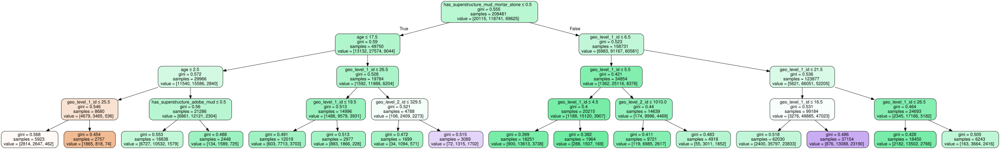

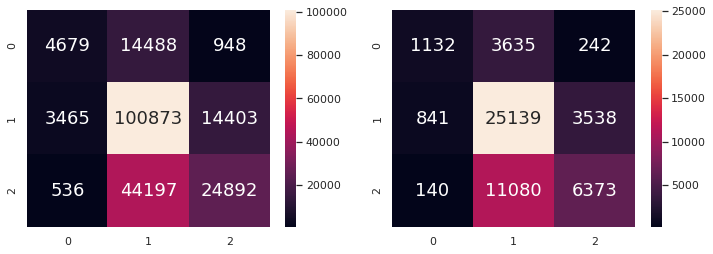

In [0]:
# Import essential models and functions from sklearn
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.tree import export_graphviz
import graphviz

# Extract Response and Predictors
ylast = pd.DataFrame(df3['damage_grade'])
Xlast = pd.DataFrame(numtrain)
# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
Xl_train, Xl_test, yl_train, yl_test = train_test_split(Xlast, ylast, test_size = no)


# Decision Tree using Train Data
dectree = DecisionTreeClassifier(max_depth = 4)  # create the decision tree object
dectree.fit(Xl_train, yl_train)                    # train the decision tree model

# Predict Response corresponding to Predictors
yl_train_pred = dectree.predict(Xl_train)
yl_test_pred = dectree.predict(Xl_test)

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", dectree.score(Xl_train, yl_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", dectree.score(Xl_test, yl_test))
print()

#Classification Metrics
from sklearn.metrics import classification_report

print(classification_report(yl_test, yl_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(yl_train, yl_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(yl_test, yl_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

# Plot the Decision Tree
treedot = export_graphviz(dectree,                                      # the model
                          feature_names = Xl_train.columns,              # the features 
                          out_file = None,                              # output file
                          filled = True,                                # node colors
                          rounded = True,                               # make pretty
                          special_characters = True)                    # postscript

graphviz.Source(treedot)

Train Size: 208481
Testing Size: 52120
Total Size: 260601
Goodness of Fit of Model 	Train Dataset
Classification Accuracy 	: 0.4414934694288688

Goodness of Fit of Model 	Test Dataset
Classification Accuracy 	: 0.4396201074443592

Accuracy: 0.4396201074443592
              precision    recall  f1-score   support

           1       0.36      0.50      0.42     20193
           2       0.66      0.21      0.32    118558
           3       0.40      0.82      0.54     69730

    accuracy                           0.44    208481
   macro avg       0.47      0.51      0.43    208481
weighted avg       0.54      0.44      0.40    208481

              precision    recall  f1-score   support

           1       0.35      0.49      0.41      4931
           2       0.66      0.21      0.32     29701
           3       0.40      0.82      0.54     17488

    accuracy                           0.44     52120
   macro avg       0.47      0.50      0.42     52120
weighted avg       0.54      0.44

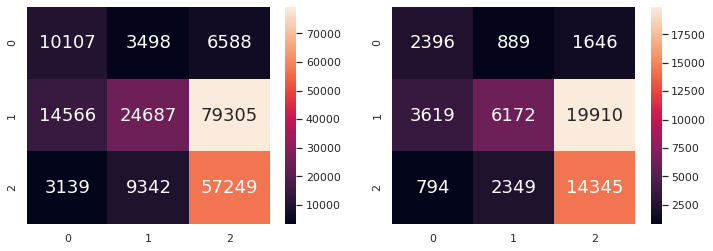

In [0]:
#Import scikit-learn metrics module for accuracy calculation
from sklearn.naive_bayes import GaussianNB
from sklearn import metrics
from sklearn.metrics import classification_report


# Extract Response and Predictors
ylasty = pd.DataFrame(df3['damage_grade'])
Xlasty = pd.DataFrame(numtrain)

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X_train, X_test, y_train, y_test = train_test_split(Xlasty, ylasty, test_size = no)


#Create a Gaussian Classifier and #rain the model using the training sets
gnb = GaussianNB()
gnb.fit(X_train, y_train.values.ravel())



#Predict the response for train & test dataset
y_train_pred = gnb.predict(X_train)
y_test_pred = gnb.predict(X_test)
 

#Import scikit-learn metrics module for accuracy calculation
from sklearn import metrics

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", gnb.score(X_train, y_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", gnb.score(X_test, y_test))
print()


# Model Accuracy, how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, y_test_pred))
print(classification_report(y_train, y_train_pred))
print(classification_report(y_test, y_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y_train, y_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y_test, y_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

In [0]:
#Import Gaussian Naive Bayes model
from sklearn.naive_bayes import GaussianNB

#Create a Gaussian Classifier
gnb = GaussianNB()

#Train the model using the training sets
gnb.fit(X_train, y_train.values.ravel())

#Predict the response for test dataset
y_pred = gnb.predict(X_test)
#Import scikit-learn metrics module for accuracy calculation
from sklearn import metrics

# Model Accuracy, how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, y_pred))
from sklearn.metrics import classification_report, confusion_matrix
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))

In [0]:
# Import essential models and functions from sklearn
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.tree import export_graphviz
import graphviz

# Extract Response and Predictors
y = pd.DataFrame(numtrain['damage_grade'])
X = pd.DataFrame(numtrain['has_secondary_use_'])

# Split the Dataset into Train and Test
print("Train Size:", num)
print("Testing Size:", no)
print("Total Size:", num+no)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = no)

# Decision Tree using Train Data
dectree = DecisionTreeClassifier(max_depth = 4)  # create the decision tree object
dectree.fit(X_train, y_train)                    # train the decision tree model

# Predict Response corresponding to Predictors
y_train_pred = dectree.predict(X_train)
y_test_pred = dectree.predict(X_test)

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Classification Accuracy \t:", dectree.score(X_train, y_train))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Classification Accuracy \t:", dectree.score(X_test, y_test))
print()

#Classification Metrics
from sklearn.metrics import classification_report

print(classification_report(y_test, y_test_pred))

# Plot the Confusion Matrix for Train and Test
f, axes = plt.subplots(1, 2, figsize=(12, 4))
sb.heatmap(confusion_matrix(y_train, y_train_pred),
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[0])
sb.heatmap(confusion_matrix(y_test, y_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 18}, ax = axes[1])

# Plot the Decision Tree
treedot = export_graphviz(dectree,                                      # the model
                          feature_names = X_train.columns,              # the features 
                          out_file = None,                              # output file
                          filled = True,                                # node colors
                          rounded = True,                               # make pretty
                          special_characters = True)                    # postscript

graphviz.Source(treedot)